## Tasks

- [x] large `median` or `gaussian filter` preprocessing improves everything
- [x] get solution up for one easy image
- [x] Solve binarization problem
    - [x] sauvola is the best
    - [x] can we find a small gaussian curve towards 255
    - [x] `cv2.AdaptiveThreshold()` has interesting results. Are they consistent? also going with strong parameters

- [ ] take care of rotated images
- [ ] take care of images with different (non-paper boundaries)

In [1]:
import os
import glob
import cv2
import numpy as np
import pandagrader.util as util
import pandagrader.text_region_extractor as tre

import matplotlib.pyplot as plt
%matplotlib inline

%load_ext autoreload
%autoreload 2

In [2]:
data_dir = '../../fsdl_data'

image_filenames = glob.glob(f'{data_dir}/*.jpg')
print('number of images:', len(image_filenames))

number of images: 70


### 2 ways to get `grayscale` image

In [77]:
def read_grayscale_image(image_filename, use_hsv_step=True):
    if not use_hsv_step:
        return util.read_image(image_filename, grayscale=True)
    
    image_bgr = util.read_image(image_filename, grayscale=False)
    image_hsv = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
    return image_hsv[:,:,2]

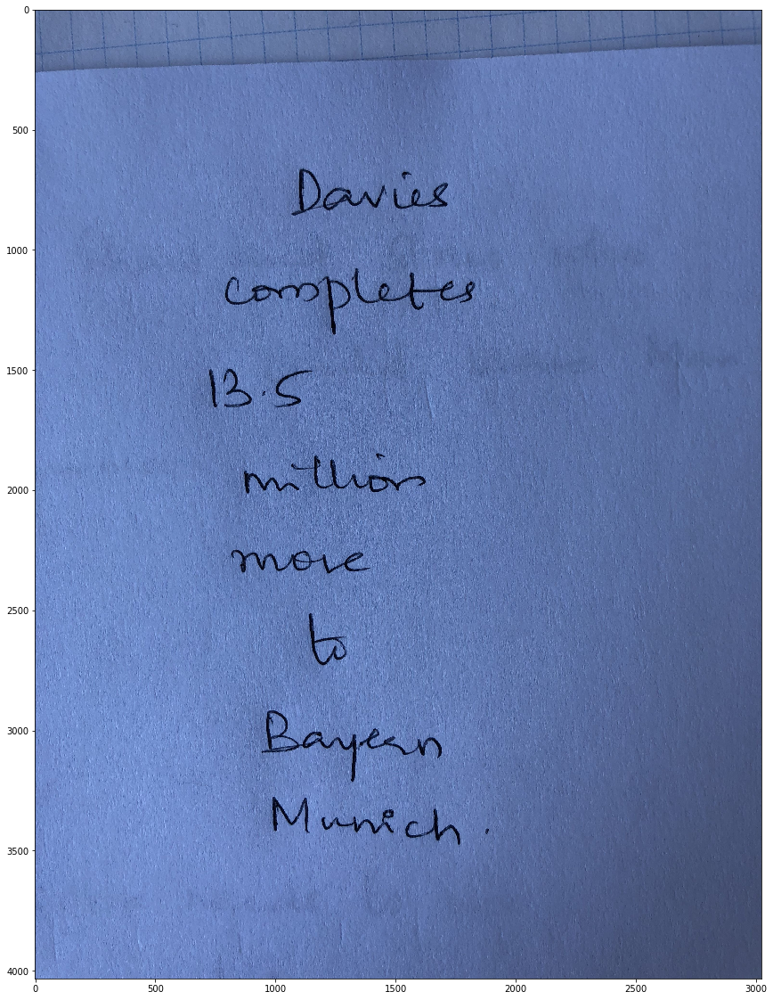

In [78]:
image_filename = f'{data_dir}/IMG_6715.jpg'
image_bgr = util.read_image(image_filename, grayscale=False)
plt.figure(figsize=(20, 20))
plt.imshow(image_bgr[...,[2, 1, 0]])

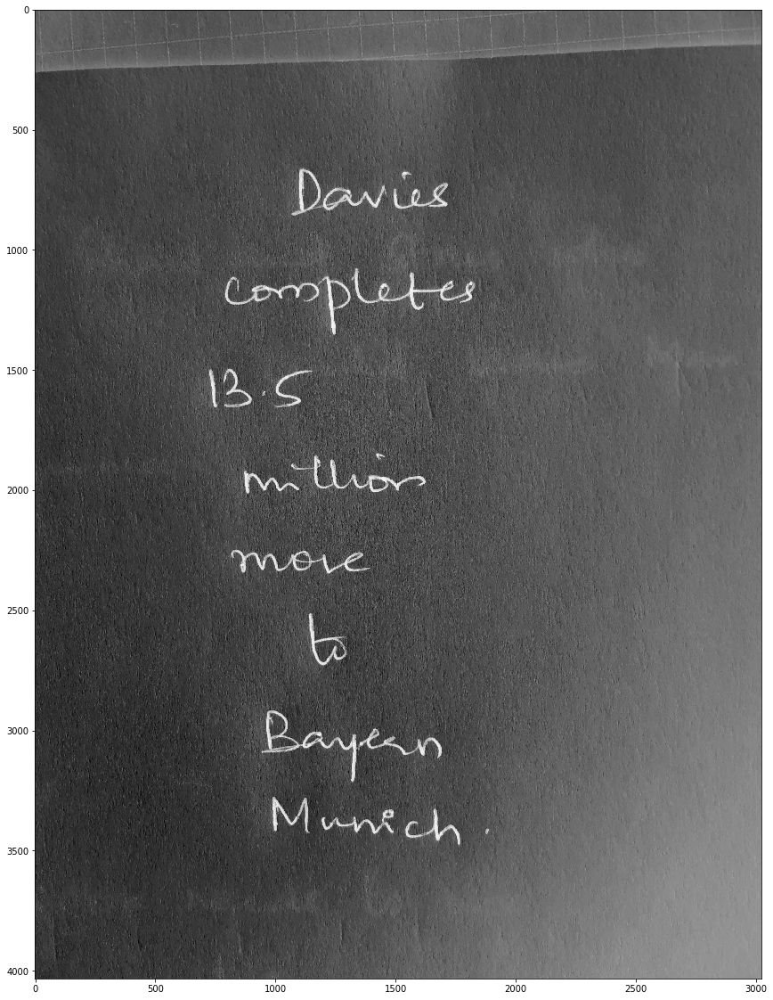

In [79]:
image_hsv = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
# plt.matshow(image_hsv[:,:,0], cmap='gray')  # hue (color)
# plt.matshow(image_hsv[:,:,1], cmap='gray')  # saturation (intensity of color)
# plt.matshow(image_hsv[:,:,2], cmap='gray')  # luminosity (grayscale aspect)
image = 255 - image_hsv[:,:,2]
plt.figure(figsize=(20, 20))
plt.imshow(image, cmap='gray')

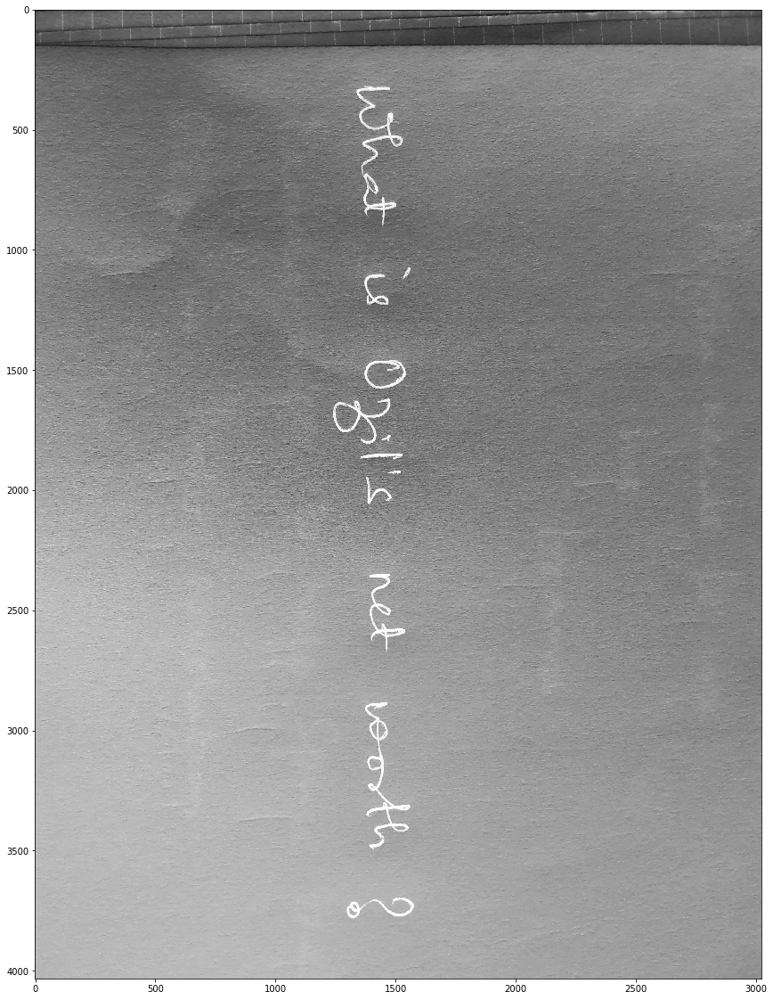

In [76]:
image_gray = read_grayscale_image(image_filename, use_hsv_step=False)
image_gray = 255 - image_gray
plt.figure(figsize=(20, 20))
plt.imshow(image_gray, cmap='gray')

## It's all about `binarization`
 - **`sauvola thresholding` is the best binarization approach**

binarizing threshold: 141.0


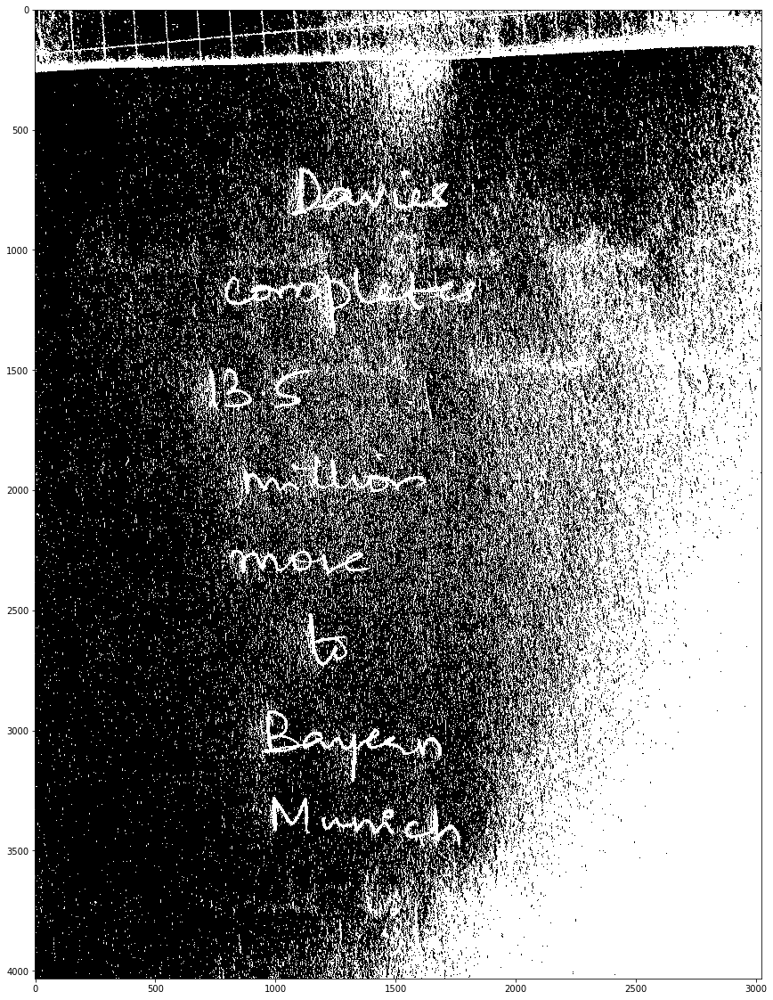

In [71]:
# binarizing is a problem
def binarize(image, plot=True):
    threshold, image_bin = cv2.threshold(image, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    print('binarizing threshold:', threshold)
    if plot:
        plt.figure(figsize=(20, 20))
        plt.imshow(image_bin, cmap='gray')
    return image_bin

image_bin = binarize(image_gray)

binarizing threshold: 88.0


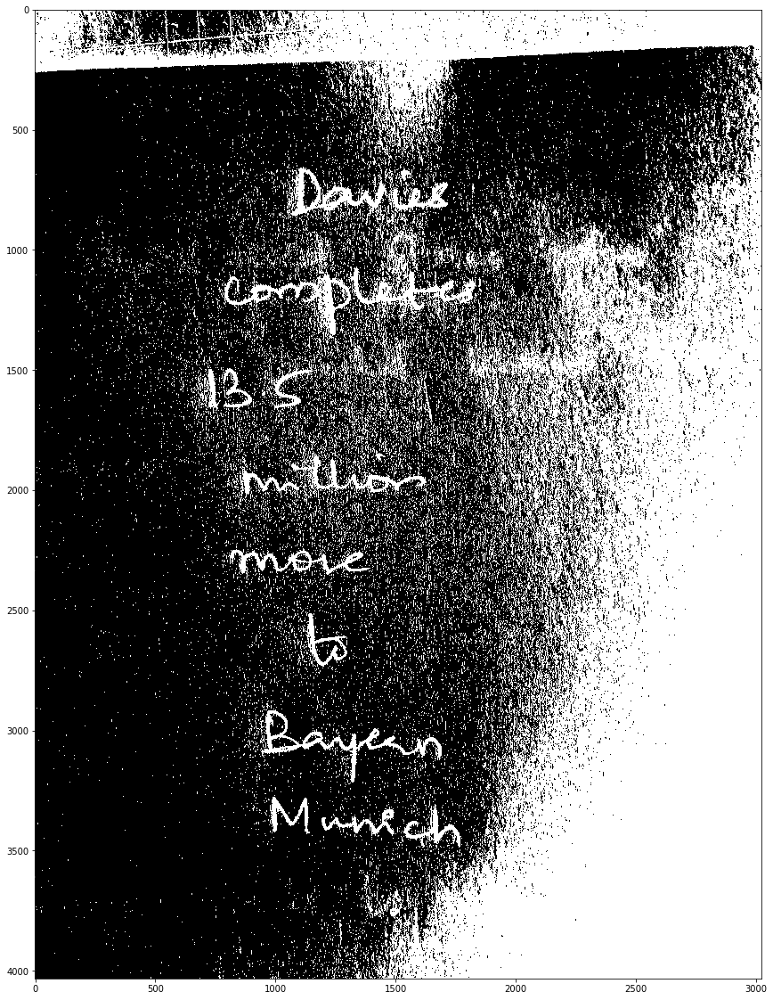

In [72]:
image_bin = binarize(image)

### binarization threshold based on image histograms

In [6]:
def plot_hist(image):
    image_hist, bins = np.histogram(image, bins=256, range=[0, 256])
#     image_hist = image_hist / np.prod(image.shape)
    image_hist = image_hist / np.max(image_hist)
    plt.figure()
    plt.title('normalized histogram')
    plt.plot(image_hist)
    Q = image_hist.cumsum()
    plt.figure()
    plt.title('histogram cumulative sum')
    plt.plot(Q)

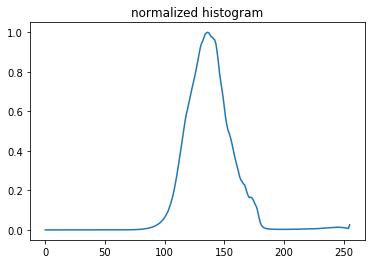

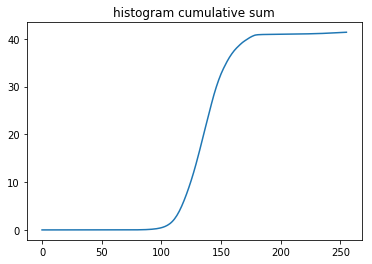

In [7]:
plot_hist(image_gray)

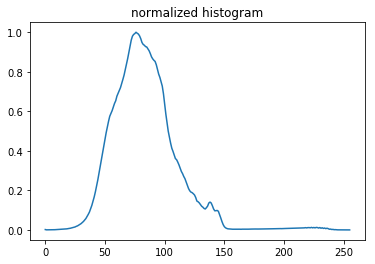

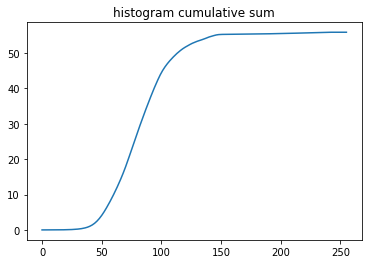

In [8]:
plot_hist(image)

### based on above plots

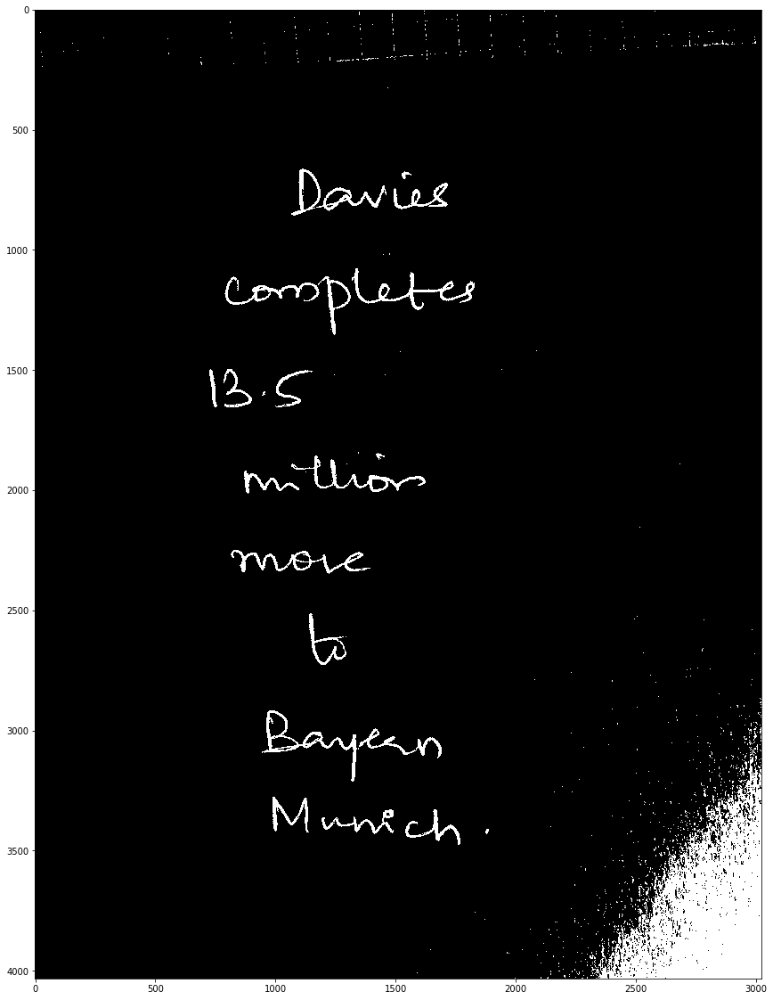

In [9]:
threshold = 135

image_thresholded = image.copy()
image_thresholded[image >= threshold] = 255
image_thresholded[image < threshold] = 0
plt.figure(figsize=(20, 20))
plt.imshow(image_thresholded, cmap='gray')

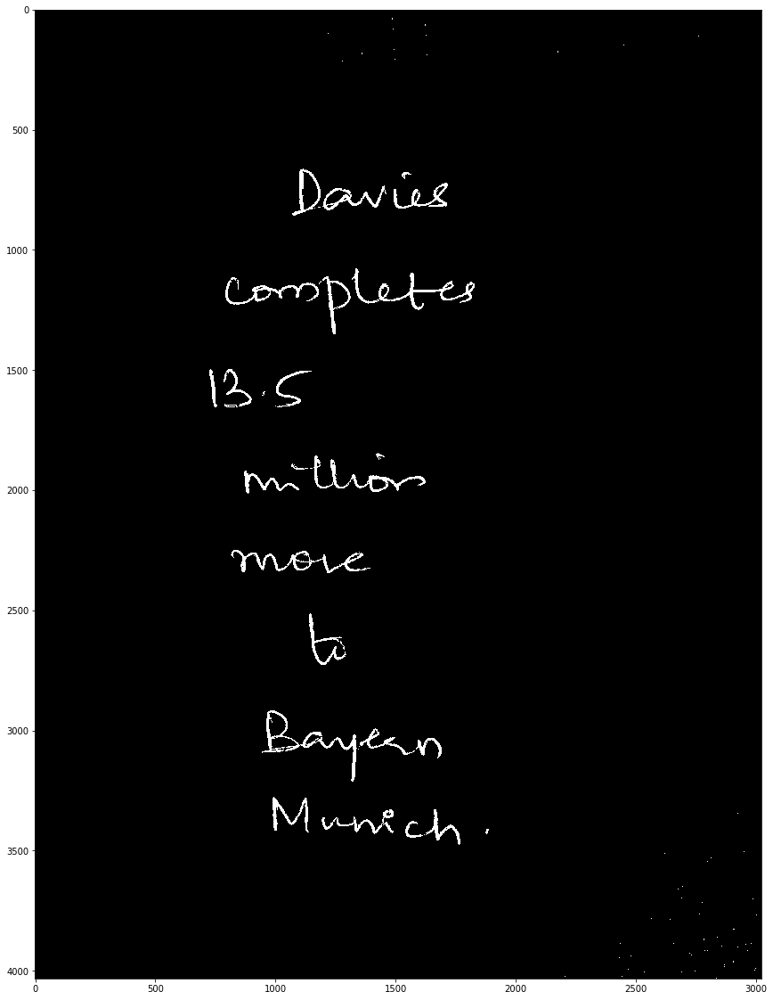

In [10]:
threshold = 155

image_thresholded = image.copy()
image_thresholded[image >= threshold] = 255
image_thresholded[image < threshold] = 0
plt.figure(figsize=(20, 20))
plt.imshow(image_thresholded, cmap='gray')

### a lot of new thresholds

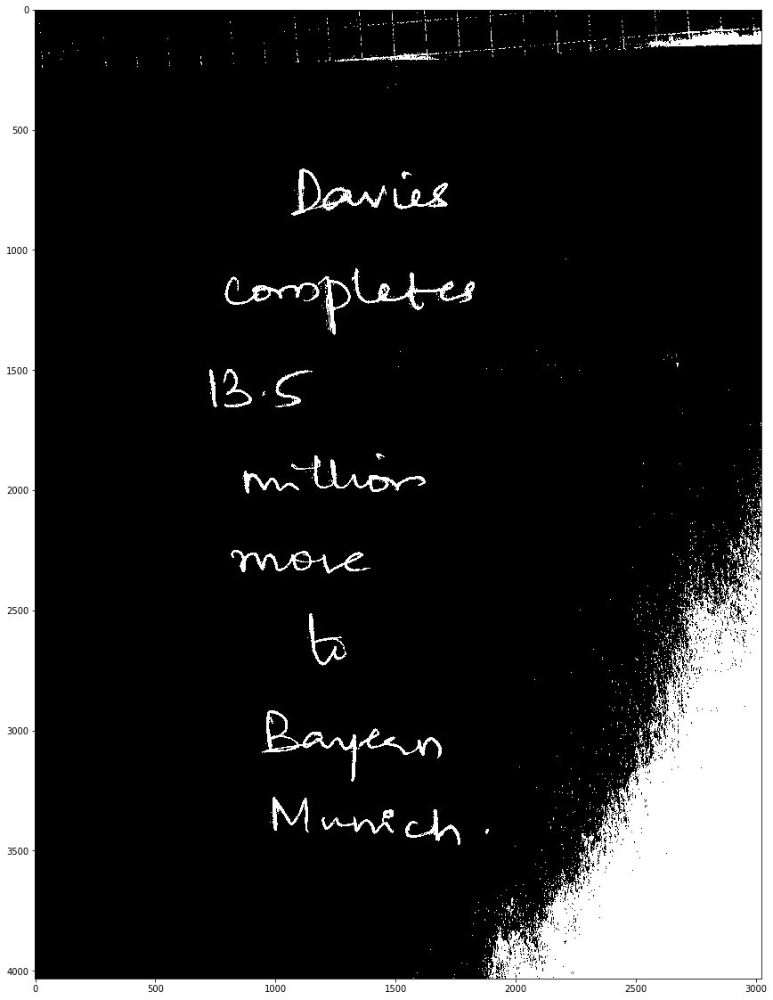

In [11]:
from skimage.filters import try_all_threshold
from skimage.filters import (threshold_otsu, threshold_niblack, threshold_sauvola)


#figs = try_all_threshold(image, figsize=(20, 20), verbose=False)

window_size = 51

# thresh_niblack = threshold_niblack(image, window_size=window_size, k=0.8)
# binary_niblack = image > thresh_niblack
# plt.figure(figsize=(20,20))
# plt.imshow(binary_niblack, cmap='gray')

thresh_sauvola = threshold_sauvola(255 - image, window_size=window_size)
binary_sauvola = image > thresh_sauvola
plt.figure(figsize=(20,20))
plt.imshow(binary_sauvola, cmap='gray')

In [12]:
for image_filename in image_filenames:
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    image = cv2.GaussianBlur(image, (21, 21), 0)
    try:
        thresh_sauvola = threshold_sauvola(image, window_size=window_size)
        binary_sauvola = (image > thresh_sauvola) * 255

        threshold_filename = os.path.splitext(image_filename)[0] + '_sauvola_gaussian_black_text.png'
        util.write_image(threshold_filename, binary_sauvola)

    except:
        print('failed for:', image_filename)

### Whole stack below with `gaussian filtering`, `sauvola thresholding`

In [64]:
import pandagrader.plotting_util as plotting_util

tre_params = {
    'aspect_ratio_percentage_cutoff': 3,
    'min_height_cutoff': 15,
    'discard_area_percentage_cutoff': 0.12,
    'discard_area_absolute_cutoff': 2.3e3,
    'discard_text_percentage_cutoff': 0.025,
    'merge_area_percentage_cutoff': 0.30,
    'merge_area_absolute_cutoff': 3500,
    'merge_distance_cutoff': 40,  # 20,
    'perform_trimming': 1,
    'dilation_kernel_length': 100,
    'gaussian_blur_size': 21,
    'concatenation_padding': 150
}

def get_overlapping_bbox(bboxes):
    merged_bbox = {}
    merged_bbox['x1'] = min([bbox['x1'] for bbox in bboxes])
    merged_bbox['y1'] = min([bbox['y1'] for bbox in bboxes])
    merged_bbox['x2'] = max([bbox['x2'] for bbox in bboxes])
    merged_bbox['y2'] = max([bbox['y2'] for bbox in bboxes])
    return merged_bbox

def cleanup_image(img: np.ndarray, blur_kernel_size: int) -> np.ndarray:
    """Performs a blur to remove noise and thresholds the image to binarize it."""
    # img = cv2.medianBlur(img, blur_kernel_size)
#     img = util.binarize_image(img)
    img = cv2.GaussianBlur(img, (blur_kernel_size, blur_kernel_size), 0)
    window_size = 51
    thresh_sauvola = threshold_sauvola(img, window_size=window_size)
    return ((img > thresh_sauvola) * 255).astype('uint8')


def horizontally_dilate_image(img: np.ndarray, dilation_kernel_length: int) -> np.ndarray:
    """Dilates with a long horizontal structuring element to bleed text together."""
    long_horizontal_kernel = np.ones((1, dilation_kernel_length), np.uint8)
    return cv2.dilate(img, long_horizontal_kernel, iterations=1)


def extract_text_regions(img: np.ndarray,
                         merge_fully_overlapping_regions: bool = True,
                         suppress_show: bool = True,
                         params = None,
                         merge_bboxes_in_line = True,
                         scan_order: bool = True):
    """
    Takes in an image with **black** text on a **white** background, and returns the list of region images
    and their corresponding bounding boxes. If suppress_show is true, it shows the image after each
    step of processing. The params variable is a
    """
    if not params:
        params = _DEFAULT_PARAMS

    # TODO: why is this suppress_show and not display_debugging_images?
    # Shows original image
    if not suppress_show:
        print('Original image:')
        plotting_util.show_image(img)

    img = cleanup_image(img, blur_kernel_size=int(params['gaussian_blur_size']))

    # inverse image - ie make text to white in black background
    preprocessed_image = (255 - img).astype('uint8')
    preprocessed_image = horizontally_dilate_image(preprocessed_image, dilation_kernel_length=int(params['dilation_kernel_length']))

    # Find contours and initial bboxes
    bboxes, contours = tre.find_bboxes(preprocessed_image)
    if not suppress_show:
        print('Initial contours and bboxes:')
        plotting_util.show_contours(contours, preprocessed_image)
        plotting_util.show_bboxes(bboxes, img)

    # Shrinks the width of the bboxes by 48px
    if params['perform_trimming']:
        bboxes = tre.trim_bboxes(bboxes, img.shape[1])
    if not suppress_show:
        print('After trimming bboxes')
        plotting_util.show_bboxes(bboxes, img)

    # Merges nearby bboxes
    bboxes = tre.merge_close_bboxes(bboxes,
                                merge_area_percentage_cutoff=params['merge_area_percentage_cutoff'],
                                merge_area_absolute_cutoff=params['merge_area_absolute_cutoff'],
                                merge_distance_cutoff=params['merge_distance_cutoff'],
                                merge_fully_overlapping_regions=merge_fully_overlapping_regions)
    if not suppress_show:
        print('After merging regions')
        plotting_util.show_bboxes(bboxes, img)

    # Discards regions with little text (small percentage of white pixels)
    regions = tre.bboxes_to_regions(bboxes, img)
    region_bbox_pairs = tre.discard_regions_with_little_text(
        list(zip(regions, bboxes)),
        discard_text_percentage_cutoff=params['discard_text_percentage_cutoff'],
        discard_area_percentage_cutoff=params['discard_area_percentage_cutoff'],
        discard_area_absolute_cutoff=params['discard_area_absolute_cutoff']
    )
    if region_bbox_pairs:
        regions, bboxes = zip(*region_bbox_pairs)
    else:
        regions, bboxes = [], []
    if not suppress_show:
        print('After discarding regions')
        plotting_util.show_bboxes(bboxes, img)

    # Discards regions with aspect ratio that does not resemble a horizontal line
    bboxes = tre.discard_bboxes_with_bad_aspect_ratio(
        bboxes,
        aspect_ratio_percentage_cutoff=params['aspect_ratio_percentage_cutoff'],
        min_height_cutoff=params['min_height_cutoff']
    )
    if not suppress_show:
        print('After removing non-line regions')
        plotting_util.show_bboxes(bboxes, img)

    if merge_bboxes_in_line:
        bboxes_per_line = tre.decompose_into_lines(bboxes)
        bboxes = [get_overlapping_bbox(bboxes) for bboxes in bboxes_per_line]
        bboxes.sort(key=lambda line_bbox: line_bbox['y1'])

    # Recalculates regions based on bboxes
    regions = tre.bboxes_to_regions(bboxes, img)
    if not suppress_show:
        plotting_util.show_regions(regions)

    return list(regions), list(bboxes)

In [67]:
for image_filename in image_filenames:
    image = read_grayscale_image(image_filename, use_hsv_step=True)

    regions, bboxes = extract_text_regions(
        image,
        merge_fully_overlapping_regions=True,  # False
        suppress_show=True,
        params=tre_params,
        scan_order=True
    )
    for i, region in enumerate(regions):
        region_filename = os.path.splitext(image_filename)[0] + f'_lineRegion-{i}.jpg'
        util.write_image(region_filename, region)

## Detecting page regions and cropping out the rest
 - I can't get opencv hough transform for lines to work - try scipy hough??
     - problem with hough - not straight lines
 - `MSER` needs to be done on grayscale (non-binary) image and it seems to be finding the text boxes pretty well (at least for 1 image). should we replace our contour based approach with MSER? It seems to be finding less noise.
     - works with both backgrounds
     - going through a few examples, MSER does excellently well in not finding spurious regions in background but also misses out on text in some cases. So it reduces False positives and false negatives creep in

TODO:
 - [ ] add border to image and then generate outer contour??
 - [ ] MSER?

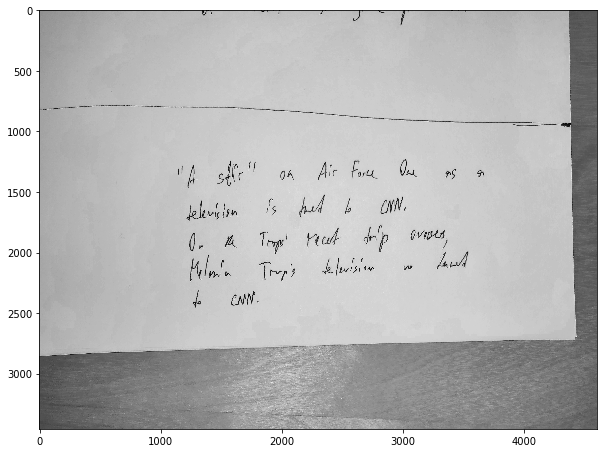

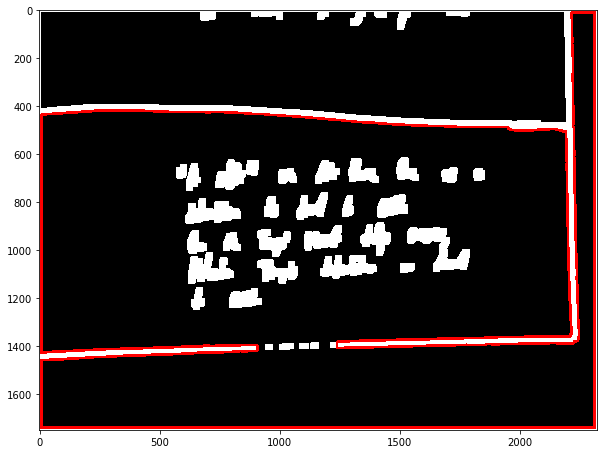

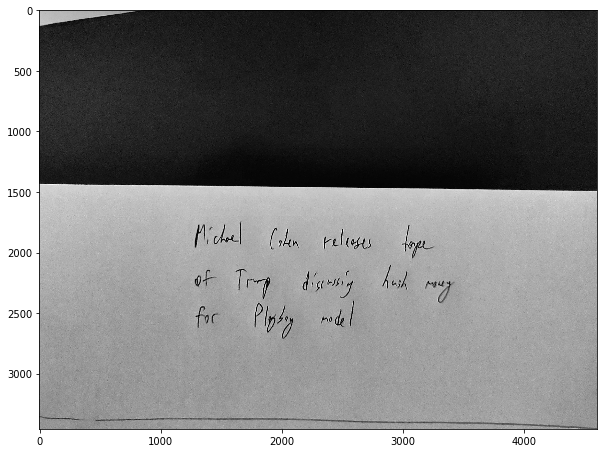

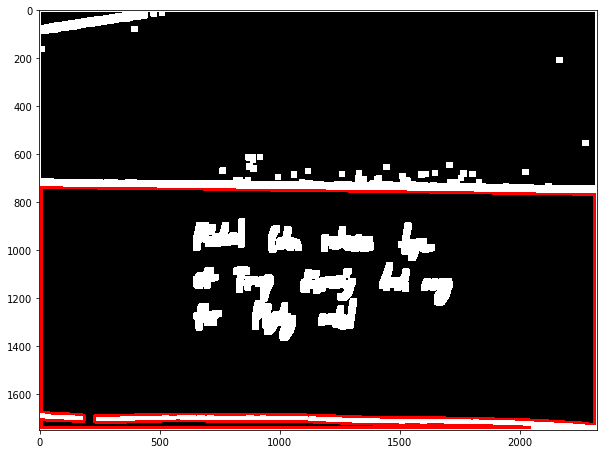

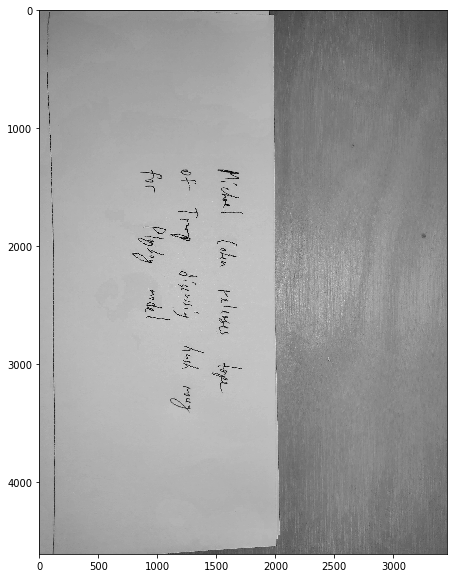

...

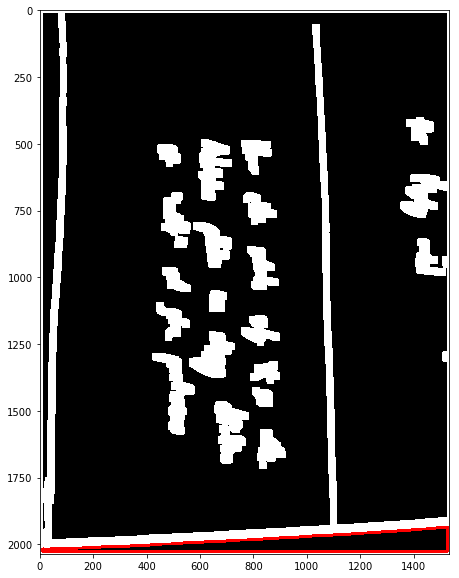

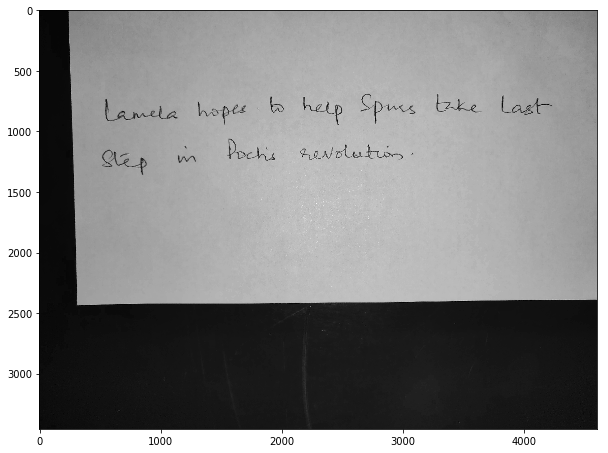

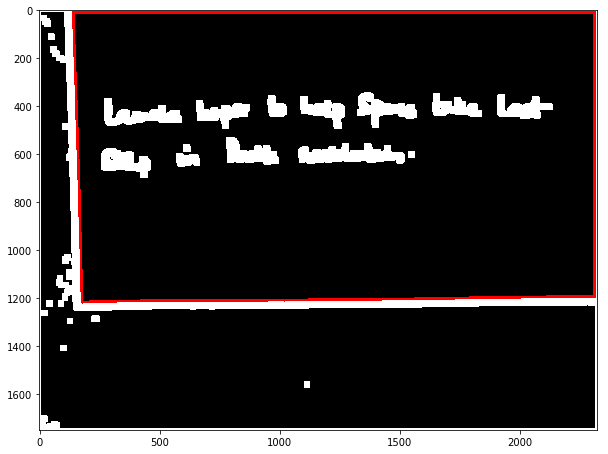

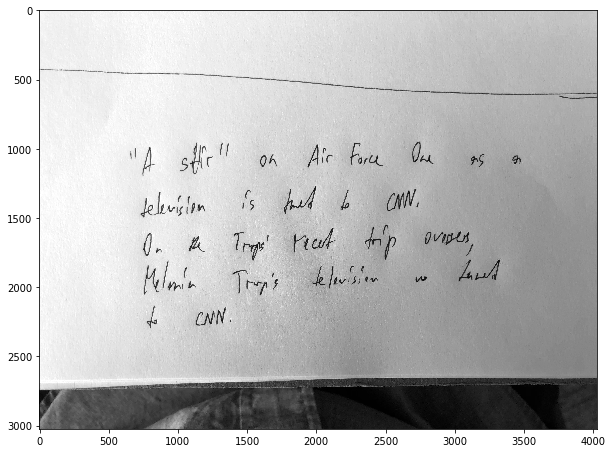

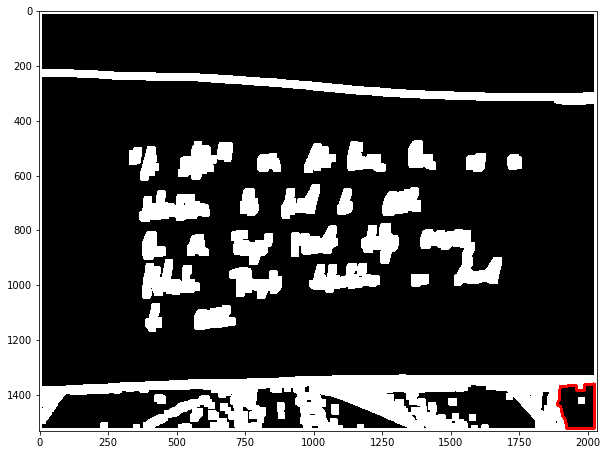

In [508]:
p_width = 10

for image_filename in image_filenames[:10]:
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')    
    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    image = 255 - image
#     image = cv2.erode(image, kernel=np.ones((3, 3), np.uint8))
    image = util.resize(image, scale_factor=0.5)

#     plt.figure(figsize=(10, 10))
#     plt.imshow(image, cmap='gray')    
    
    image = cv2.dilate(image, kernel=np.ones((25, 25), np.uint8))
    image = util.binarize_image(image)
    image = np.pad(image, ((p_width, p_width), (p_width, p_width)), mode='constant', constant_values=255)

    _, contours, hierarchy = cv2.findContours(image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours = [cnt for cnt, _bool in zip(contours, hierarchy[0][:, 3] == 0) if _bool == True]
    contours = sorted(contours, key=lambda cnt: cv2.boundingRect(cnt), reverse=True)

    cnt_img = cv2.drawContours(np.dstack([image, image, image]), contours, 0, (255,0,0), 10)
    plt.figure(figsize=(10, 10))
    plt.imshow(cnt_img)    

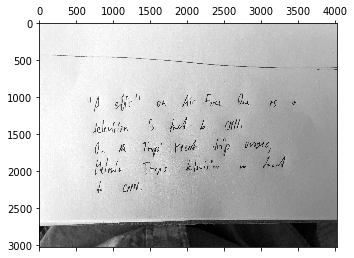

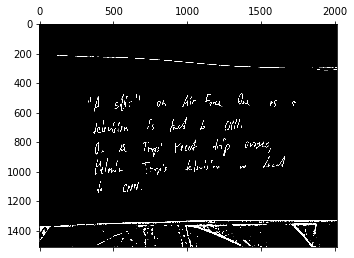

In [461]:
image_filename = f'{data_dir}/IMG_6711.jpg'
image = read_grayscale_image(image_filename, use_hsv_step=True)
plt.matshow(image, cmap='gray')

# image = cv2.GaussianBlur(image, (tre_params['gaussian_blur_size'], tre_params['gaussian_blur_size']), 0)
image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
image = 255 - image
image = util.resize(image, scale_factor=0.5)
plt.matshow(image, cmap='gray')

### `Contour` approach

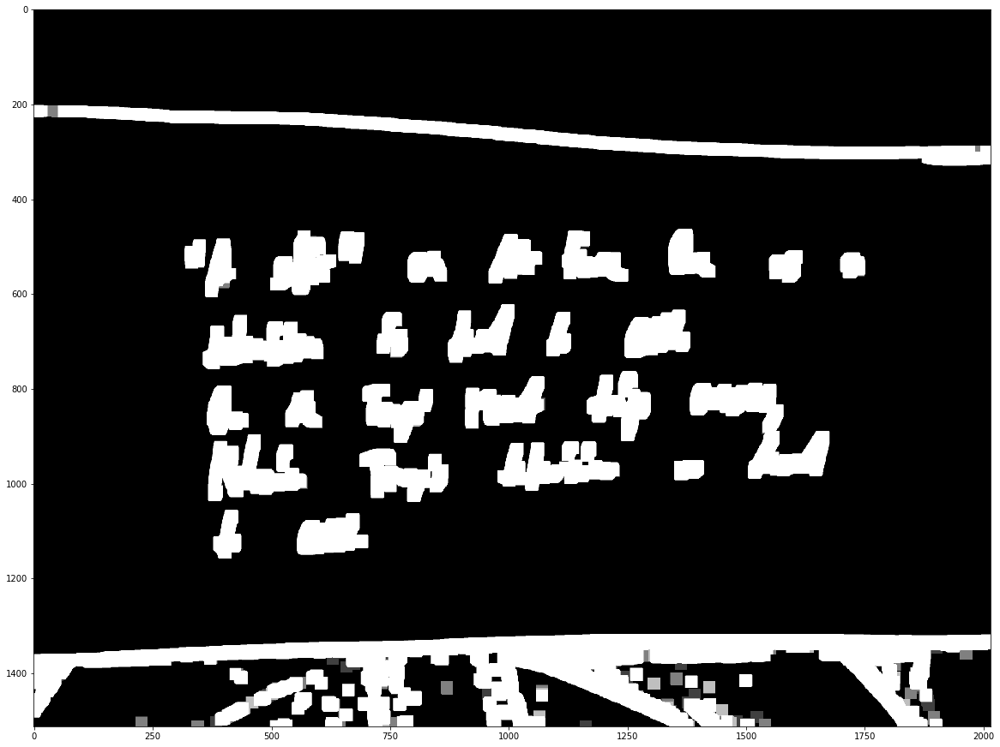

In [463]:
p_image = cv2.erode(image, kernel=np.ones((3, 3), np.uint8))
p_image = cv2.dilate(p_image, kernel=np.ones((25, 25), np.uint8))
plt.figure(figsize=(20, 20))
plt.imshow(p_image, cmap='gray')

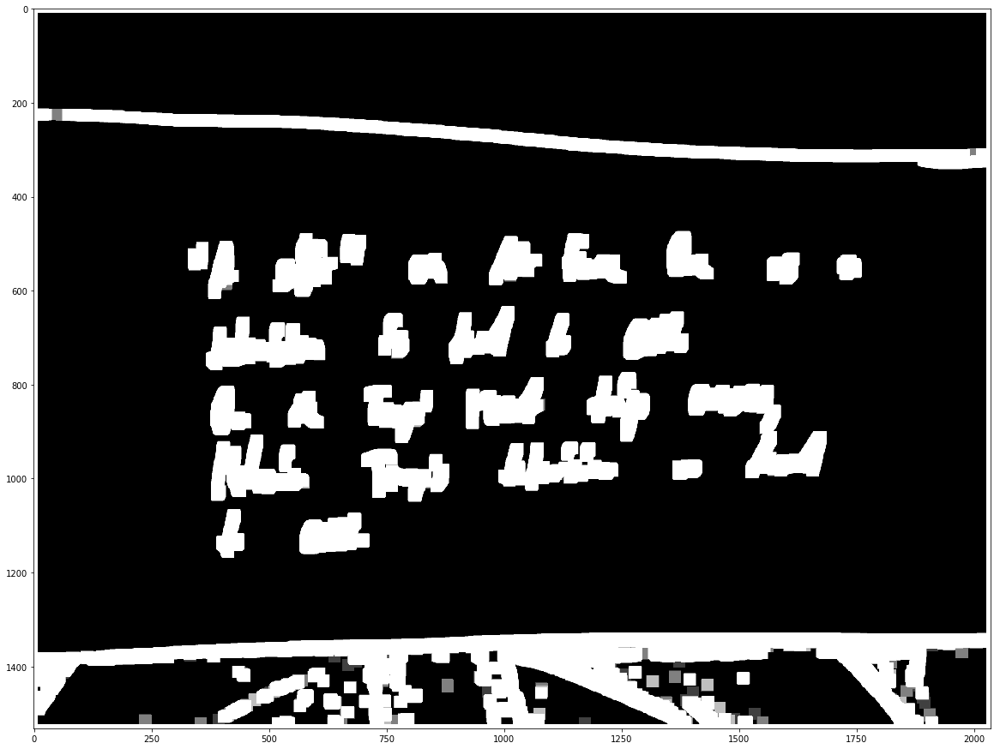

In [464]:
p_width = 10
p_image = np.pad(p_image, ((p_width, p_width), (p_width, p_width)), mode='constant', constant_values=255)
plt.figure(figsize=(20, 20))
plt.imshow(p_image, cmap='gray')

In [465]:
_, contours, hierarchy = cv2.findContours(p_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
hierarchy = hierarchy[0]
len(contours)

67

In [466]:
hierarchy

array([[-1, -1,  1, -1],
       [ 2, -1, -1,  0],
       [ 3,  1, -1,  0],
       [ 4,  2, -1,  0],
       [ 5,  3, -1,  0],
       [ 6,  4, -1,  0],
       [ 7,  5, -1,  0],
       [ 8,  6, -1,  0],
       [ 9,  7, -1,  0],
       [10,  8, -1,  0],
       [11,  9, -1,  0],
       [12, 10, -1,  0],
       [13, 11, -1,  0],
       [14, 12, -1,  0],
       [16, 13, 15,  0],
       [-1, -1, -1, 14],
       [17, 14, -1,  0],
       [18, 16, -1,  0],
       [19, 17, -1,  0],
       [22, 18, 20,  0],
       [21, -1, -1, 19],
       [-1, 20, -1, 19],
       [24, 19, 23,  0],
       [-1, -1, -1, 22],
       [25, 22, -1,  0],
       [31, 24, 26,  0],
       [27, -1, -1, 25],
       [28, 26, -1, 25],
       [29, 27, -1, 25],
       [30, 28, -1, 25],
       [-1, 29, -1, 25],
       [32, 25, -1,  0],
       [66, 31, 33,  0],
       [34, -1, -1, 32],
       [35, 33, -1, 32],
       [36, 34, -1, 32],
       [39, 35, 37, 32],
       [38, -1, -1, 36],
       [-1, 37, -1, 36],
       [41, 36, 40, 32],


In [467]:
contours = [cnt for cnt, _bool in zip(contours, hierarchy[:, 3] == 0) if _bool == True]
hierarchy = hierarchy[hierarchy[:, 3] == 0]
len(contours)

24

In [468]:
contours = sorted(contours, key=lambda cnt: cv2.contourArea(cnt), reverse=True)

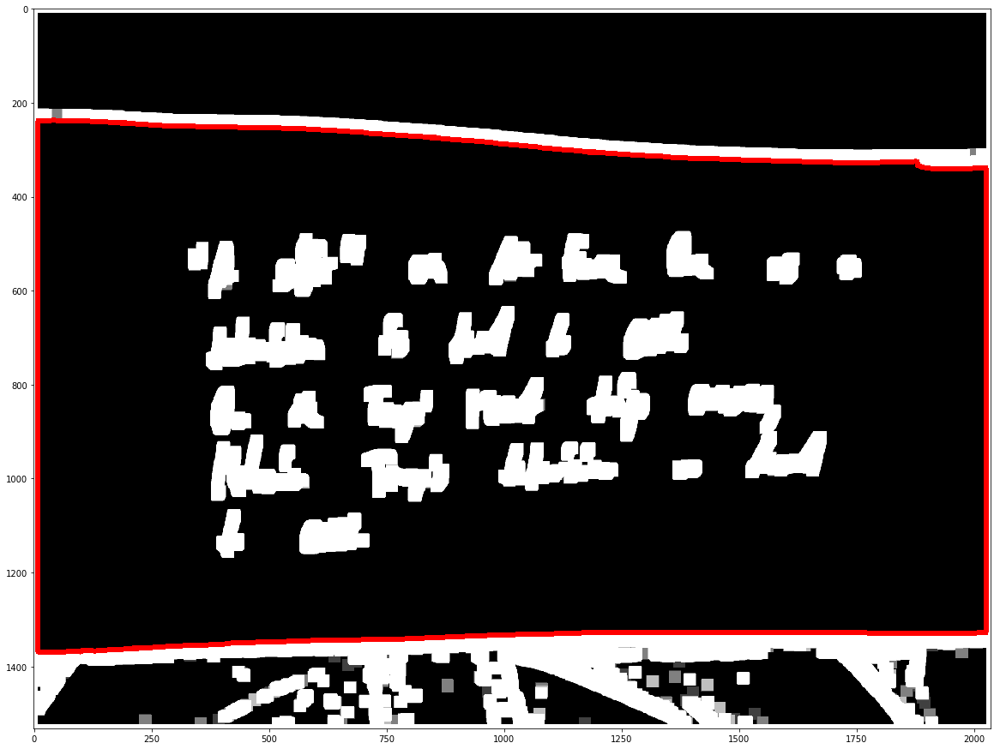

In [469]:
cnt_img = cv2.drawContours(np.dstack([p_image, p_image, p_image]), contours, 0, (255,0,0), 10)
plt.figure(figsize=(20, 20))
plt.imshow(cnt_img)

### `MSER`

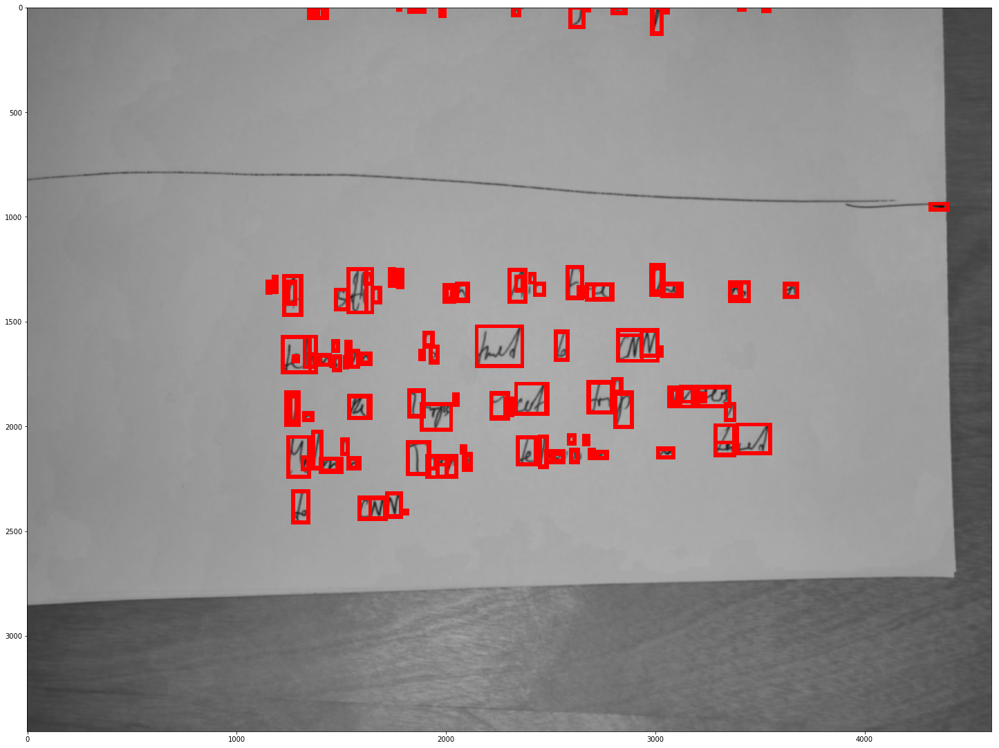

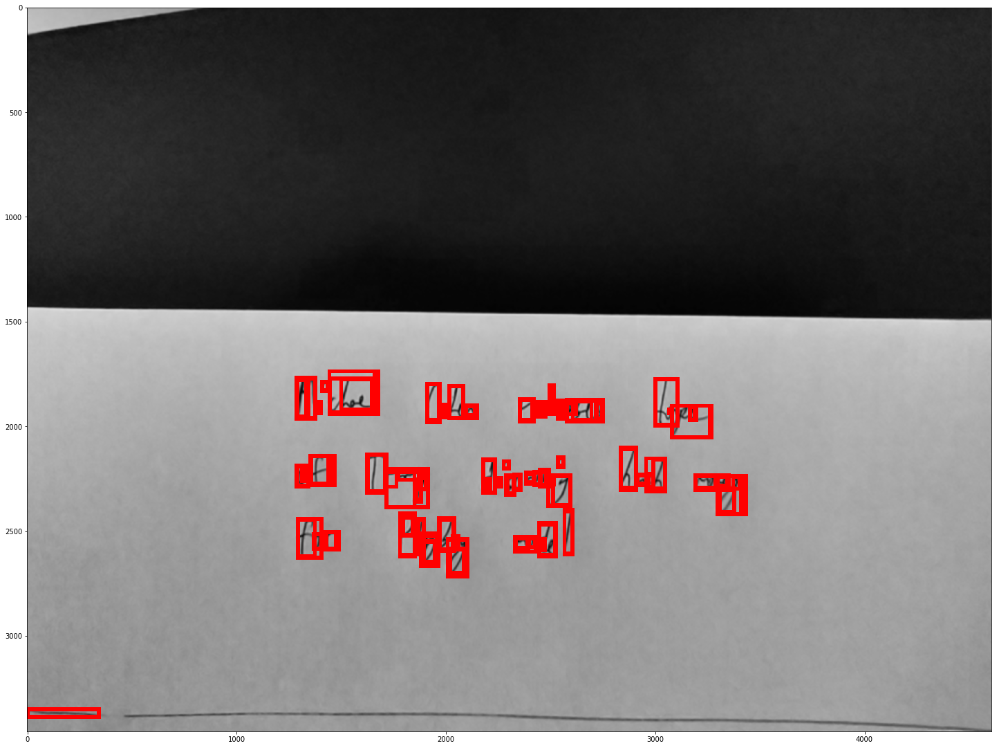

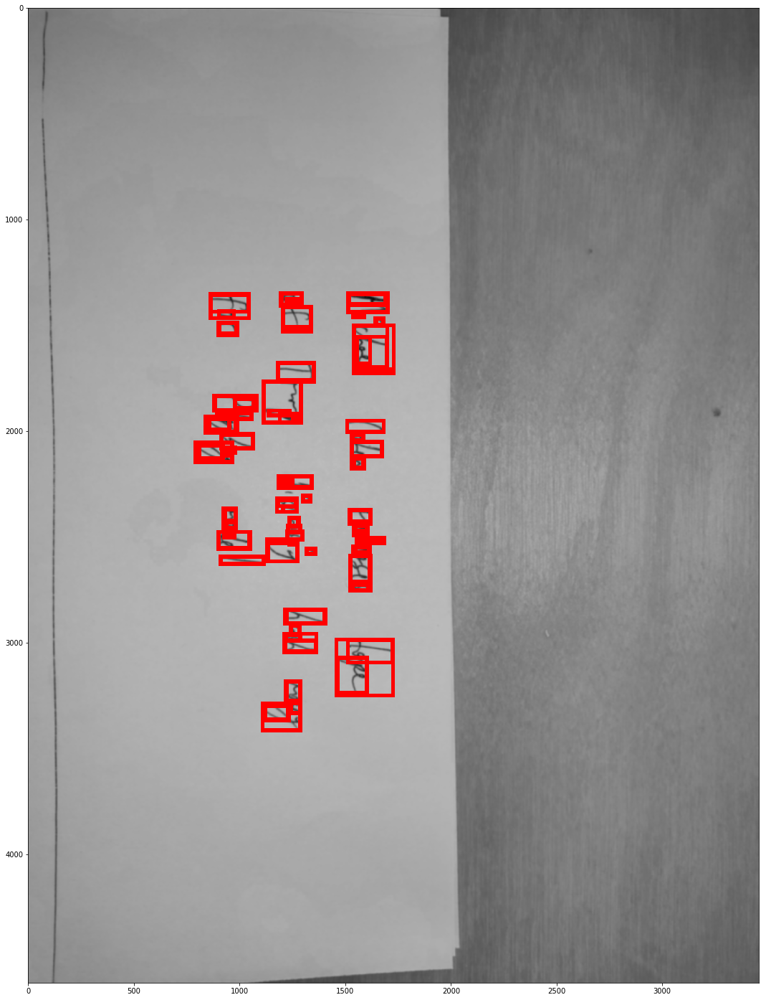

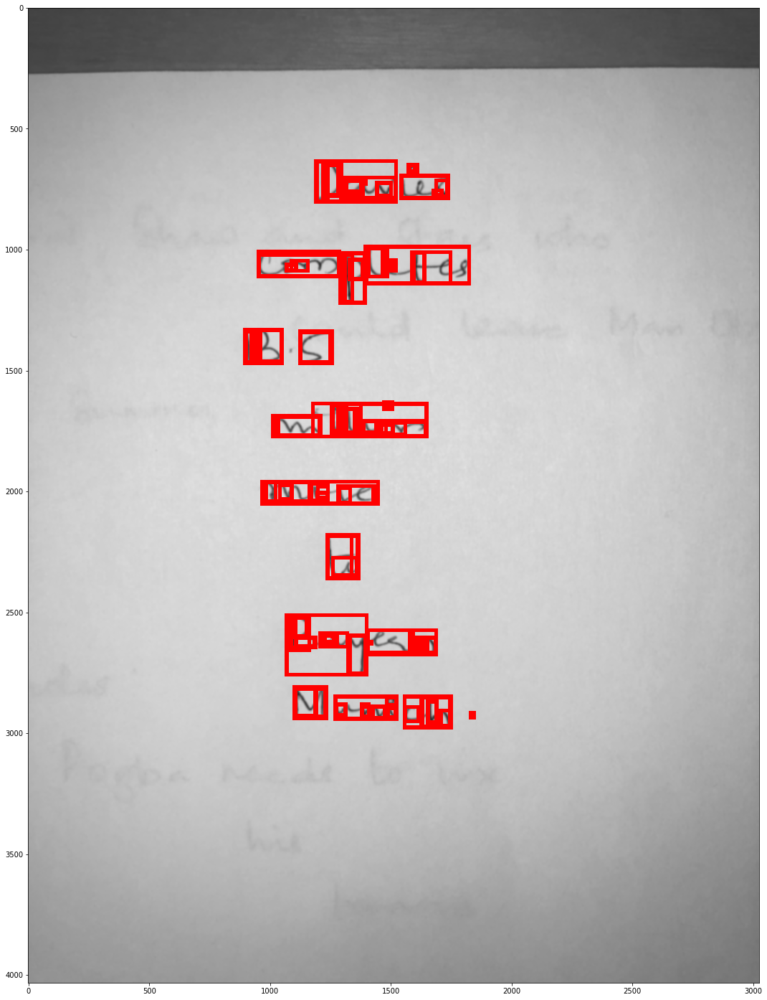

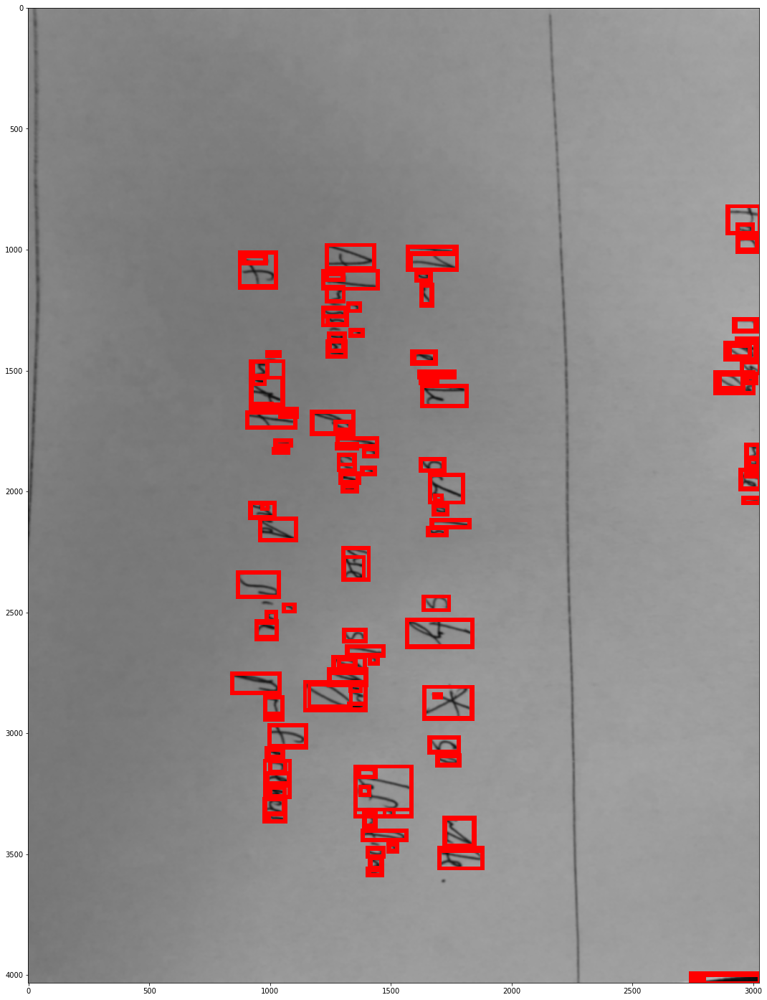

...

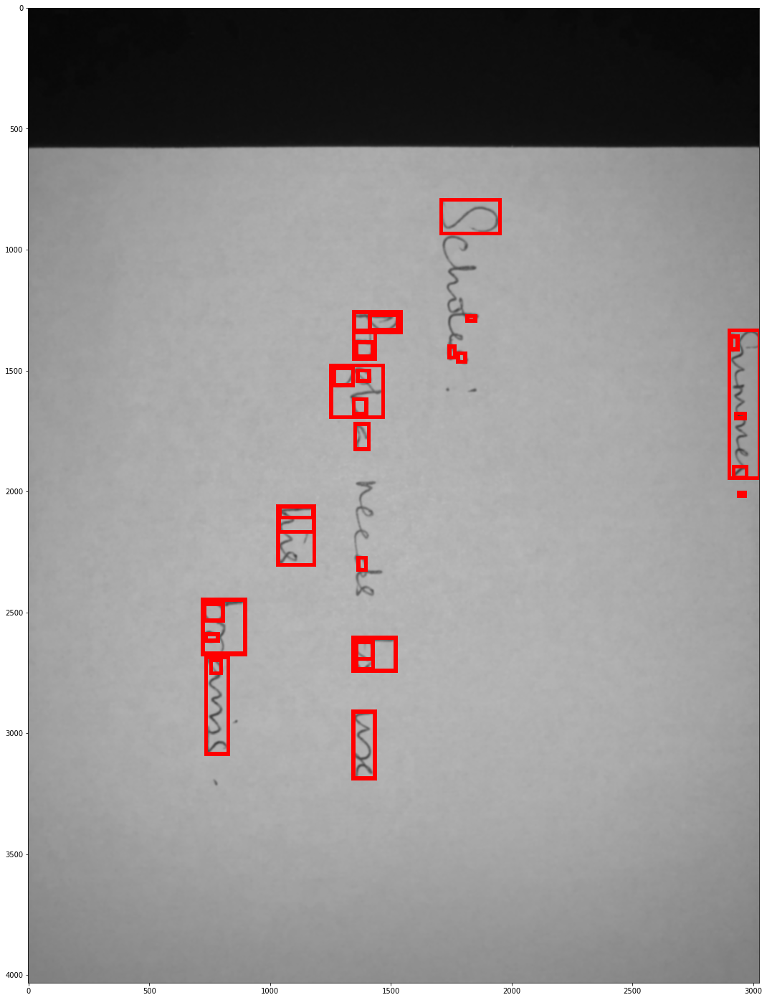

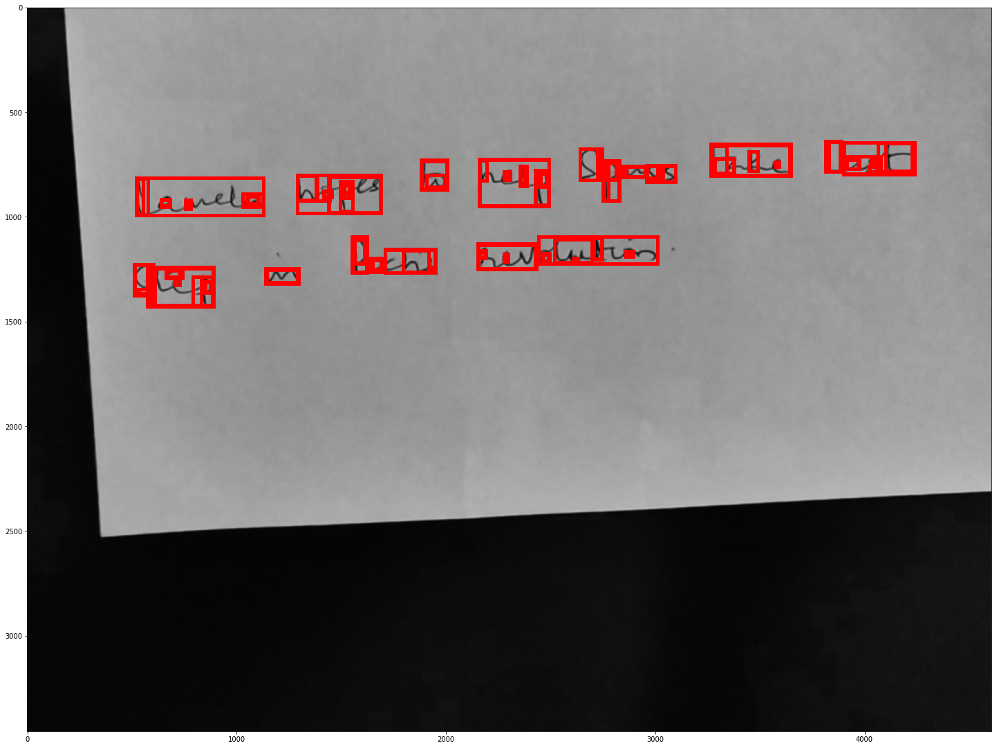

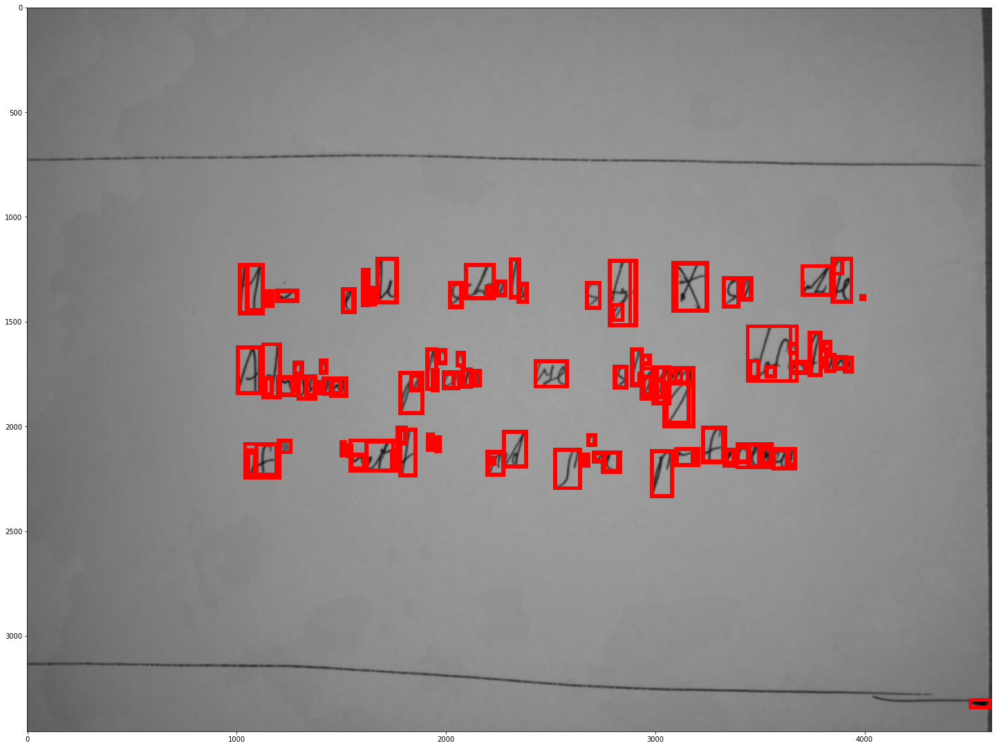

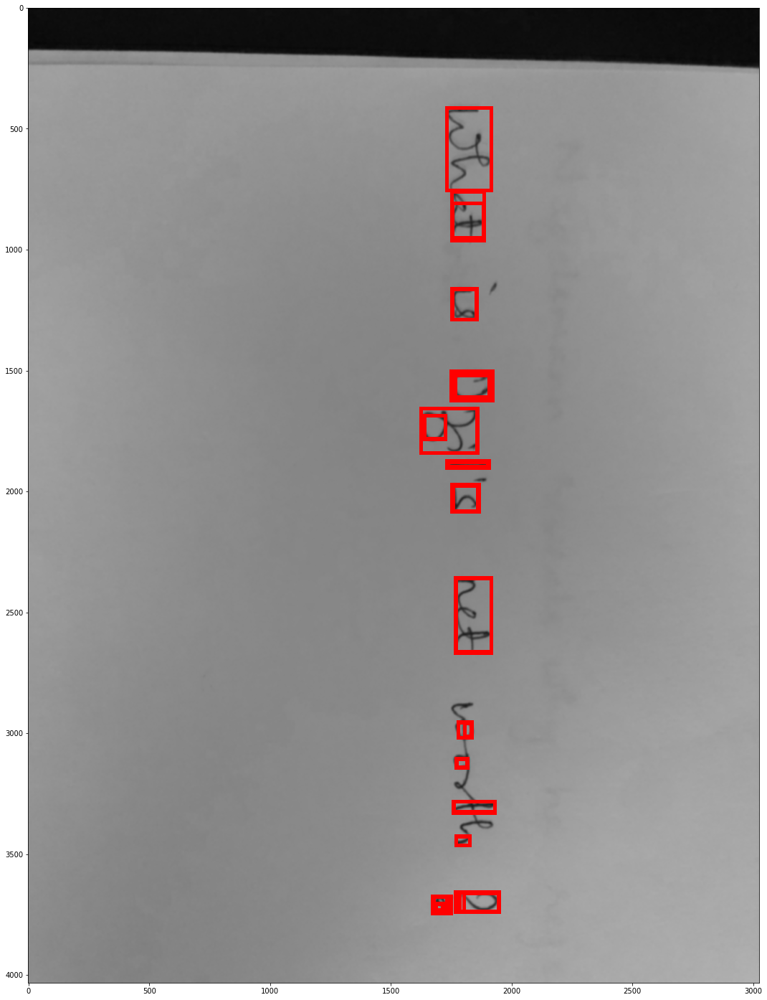

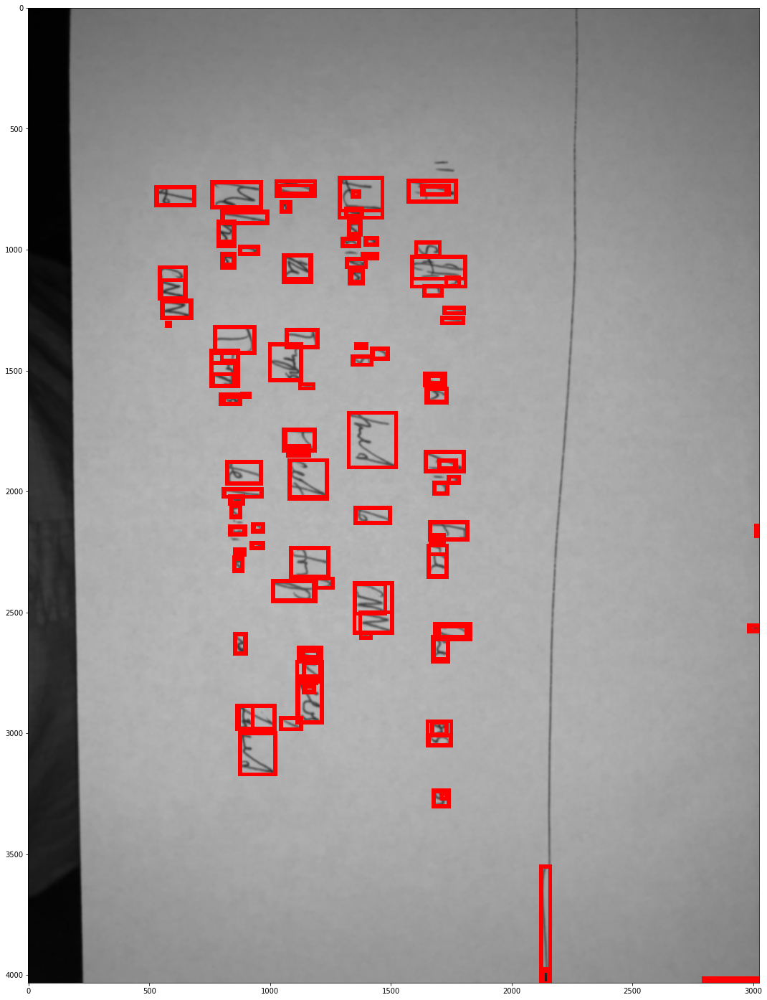

In [363]:
mser = cv2.MSER_create()

for image_filename in image_filenames[:20]:
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    image = cv2.GaussianBlur(image, (tre_params['gaussian_blur_size'], tre_params['gaussian_blur_size']), 0)
    regions, bboxes = mser.detectRegions(image)
    plotting_util.show_bboxes(util.xywh_rects_to_region_dicts(bboxes), image)

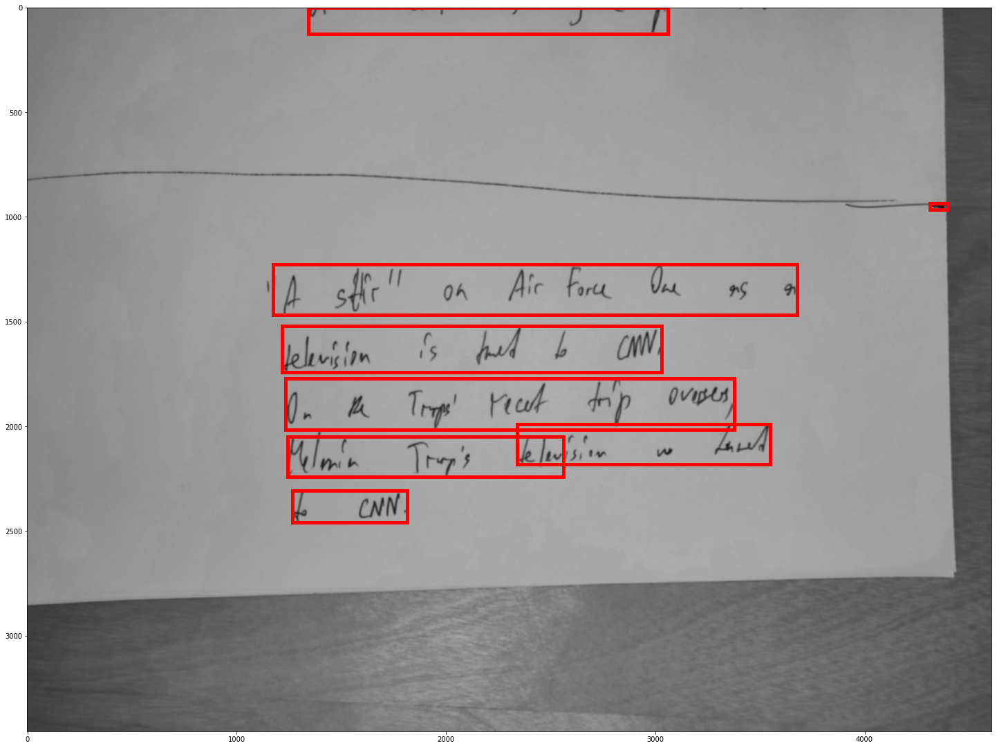

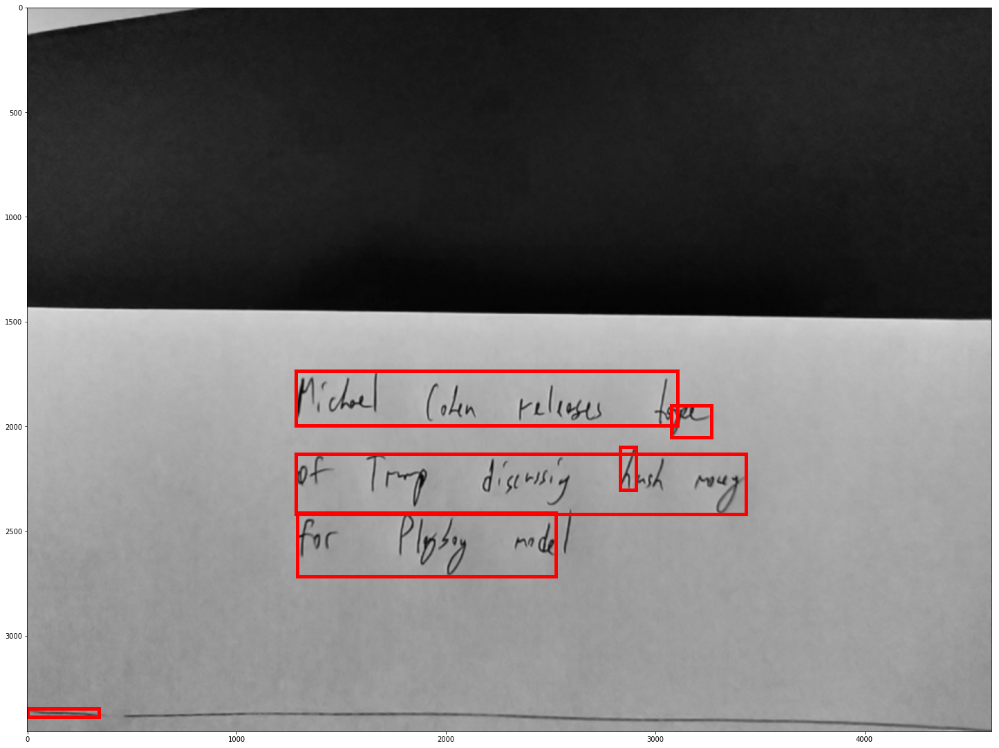

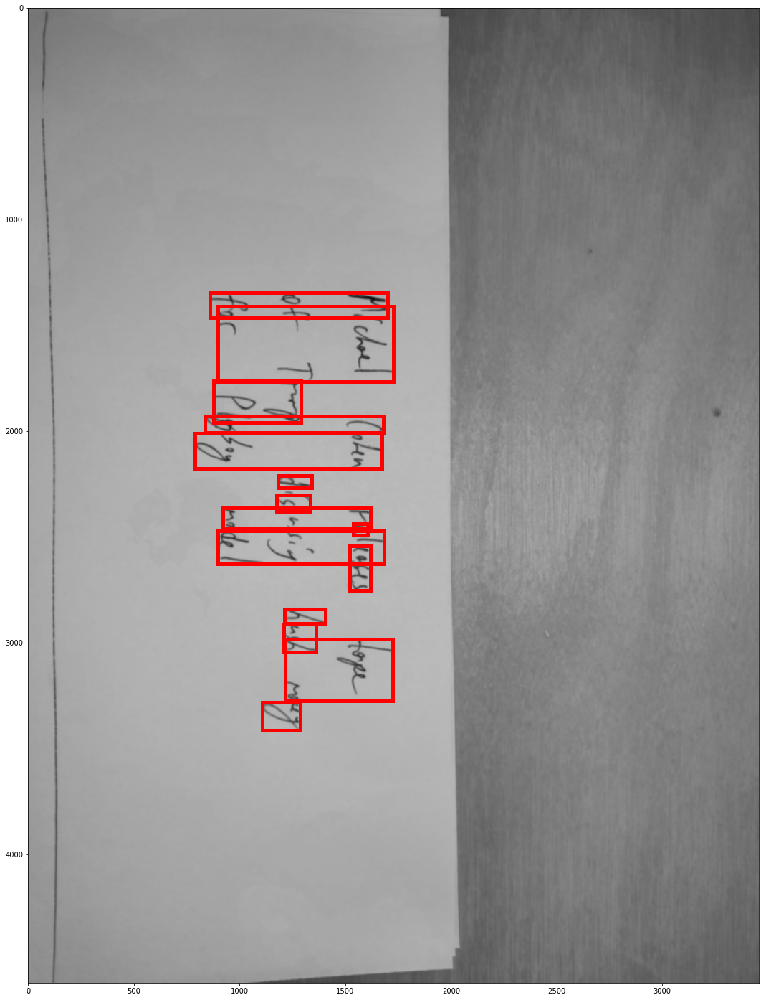

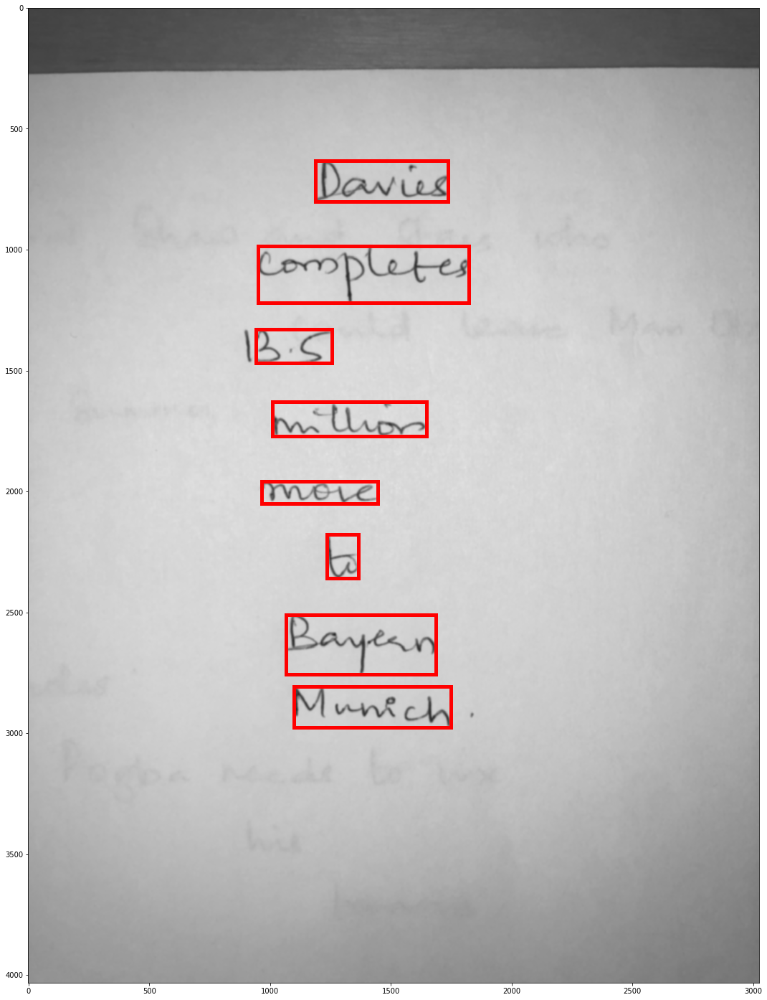

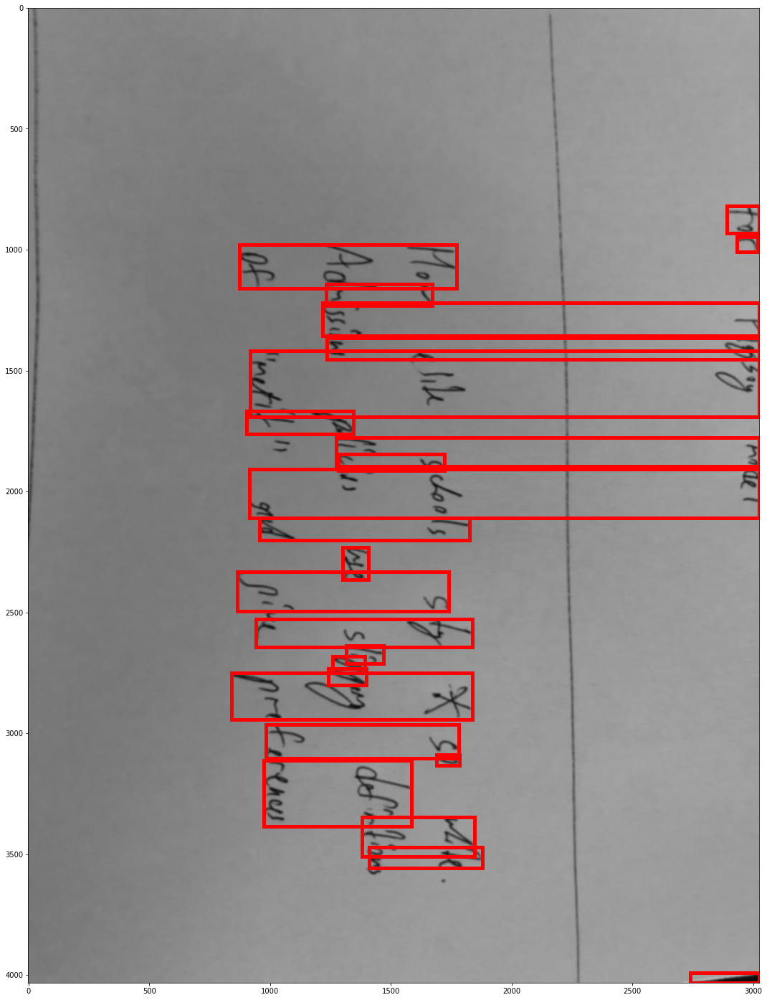

...

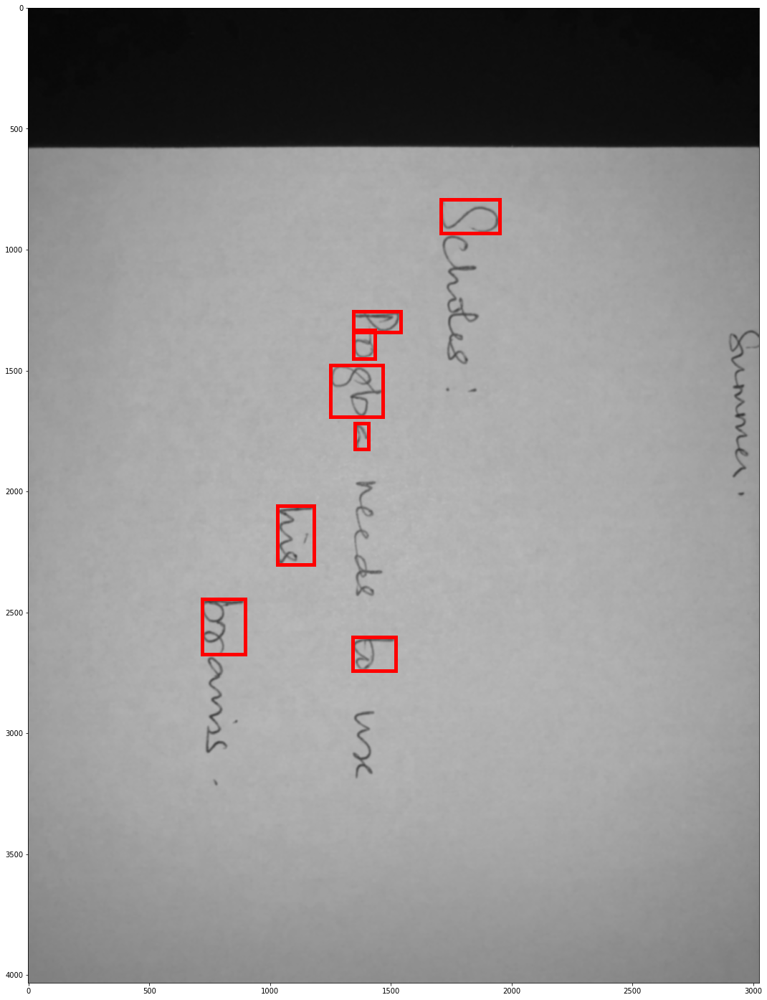

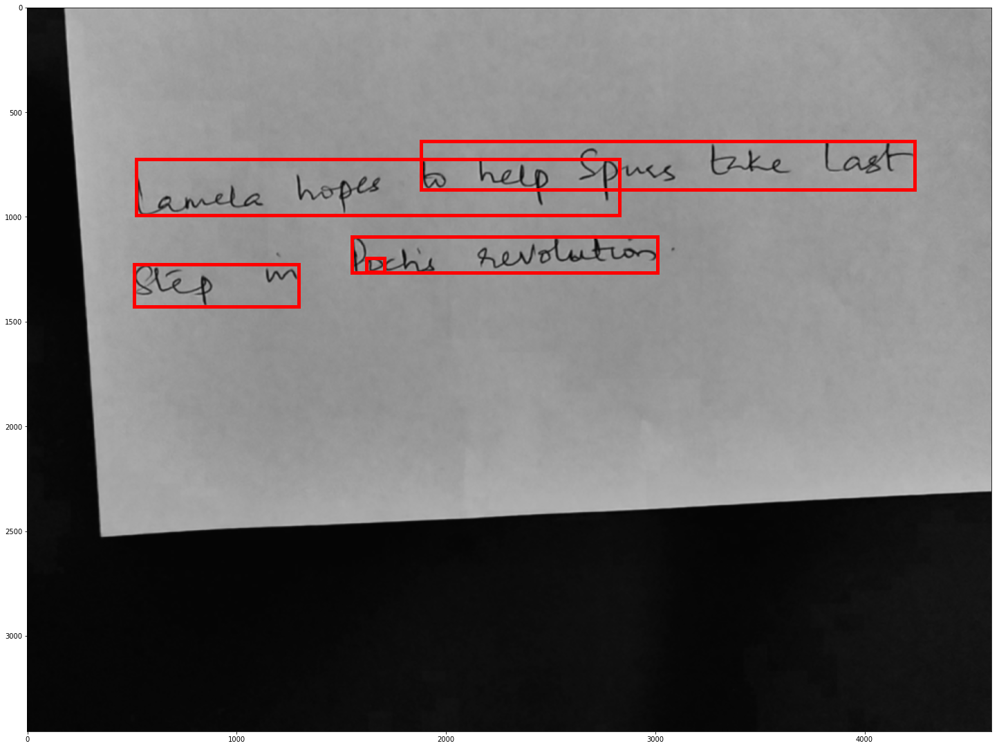

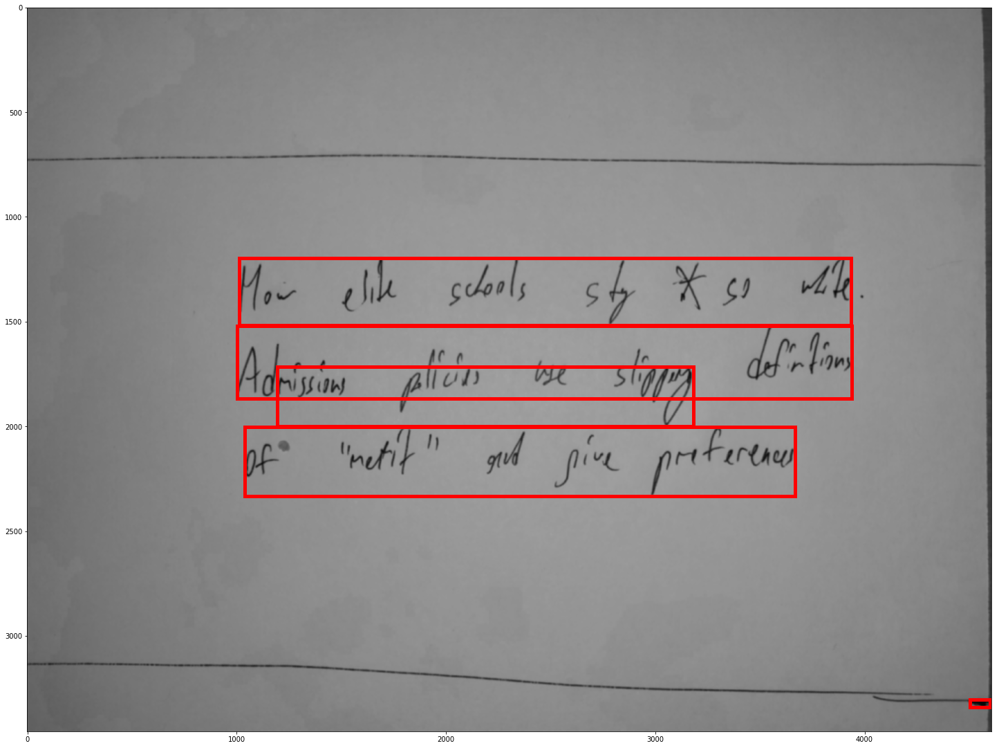

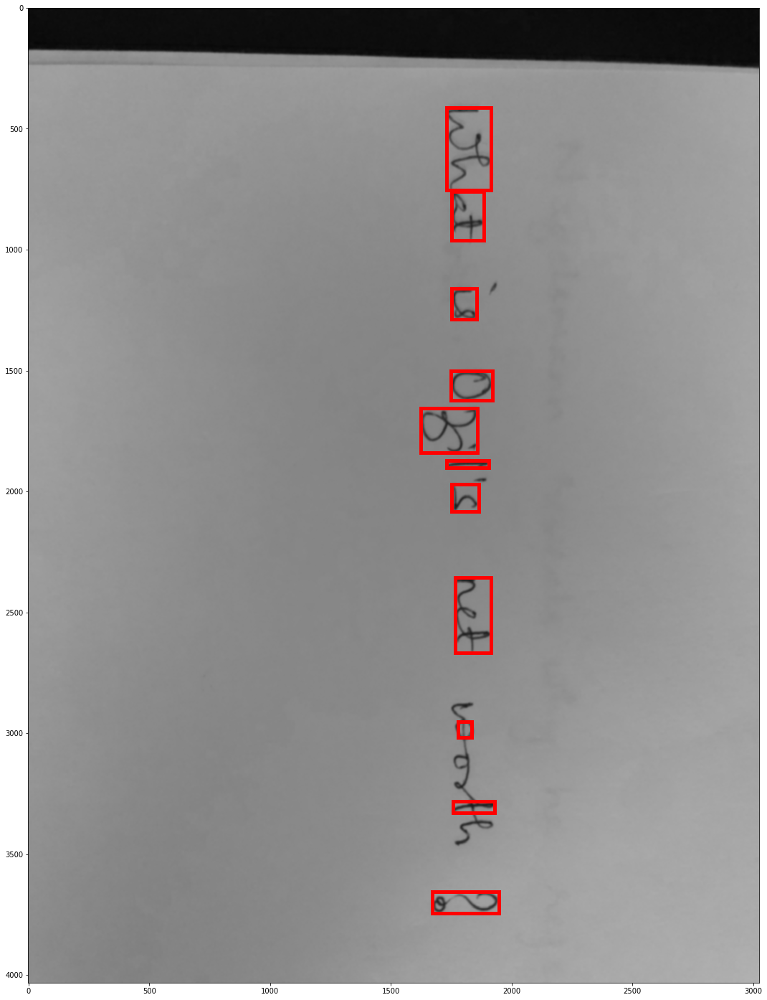

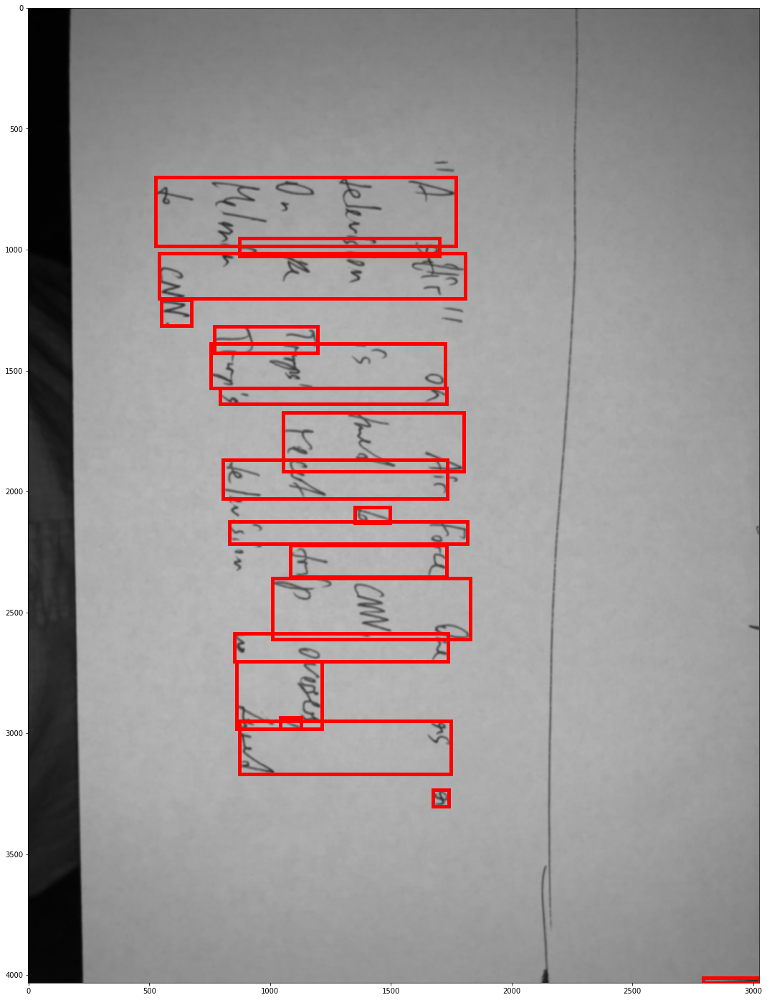

In [485]:
mser = cv2.MSER_create()
params = tre_params
merge_fully_overlapping_regions = True
merge_bboxes_in_line = True

for image_filename in image_filenames[:20]:
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    image = cv2.GaussianBlur(image, (tre_params['gaussian_blur_size'], tre_params['gaussian_blur_size']), 0)
    regions, bboxes = mser.detectRegions(image)
    bboxes = util.xywh_rects_to_region_dicts(bboxes)
    bboxes = tre.merge_close_bboxes(bboxes,
                                merge_area_percentage_cutoff=params['merge_area_percentage_cutoff'],
                                merge_area_absolute_cutoff=params['merge_area_absolute_cutoff'],
                                merge_distance_cutoff=params['merge_distance_cutoff'],
                                merge_fully_overlapping_regions=merge_fully_overlapping_regions)

    # Discards regions with little text (small percentage of white pixels)
    regions = tre.bboxes_to_regions(bboxes, image)
    region_bbox_pairs = tre.discard_regions_with_little_text(
        list(zip(regions, bboxes)),
        discard_text_percentage_cutoff=params['discard_text_percentage_cutoff'],
        discard_area_percentage_cutoff=params['discard_area_percentage_cutoff'],
        discard_area_absolute_cutoff=params['discard_area_absolute_cutoff']
    )
    if region_bbox_pairs:
        regions, bboxes = zip(*region_bbox_pairs)
    else:
        regions, bboxes = [], []

    # Discards regions with aspect ratio that does not resemble a horizontal line
    bboxes = tre.discard_bboxes_with_bad_aspect_ratio(
        bboxes,
        aspect_ratio_percentage_cutoff=params['aspect_ratio_percentage_cutoff'],
        min_height_cutoff=params['min_height_cutoff']
    )
    if merge_bboxes_in_line:
        bboxes_per_line = tre.decompose_into_lines(bboxes)
        bboxes = [get_overlapping_bbox(bboxes) for bboxes in bboxes_per_line]
        bboxes.sort(key=lambda line_bbox: line_bbox['y1'])

    # Recalculates regions based on bboxes
    regions = tre.bboxes_to_regions(bboxes, image)
    plotting_util.show_bboxes(bboxes, image)
    #plotting_util.show_regions(regions)

### `Hough for lines`

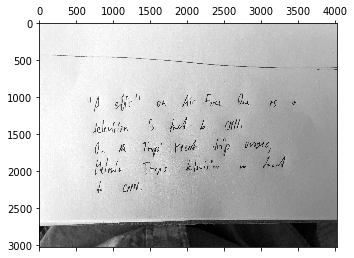

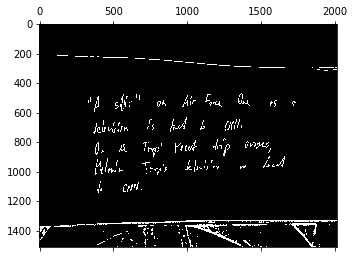

In [490]:
image_filename = f'{data_dir}/IMG_6711.jpg'
image = read_grayscale_image(image_filename, use_hsv_step=True)
plt.matshow(image, cmap='gray')

# image = cv2.GaussianBlur(image, (tre_params['gaussian_blur_size'], tre_params['gaussian_blur_size']), 0)
image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
image = 255 - image
image = util.resize(image, scale_factor=0.5)
image = util.binarize_image(image)
plt.matshow(image, cmap='gray')

1358.9788952259712 1323.5928551791162
1373.618521313432 1302.8246300650192
1336.7652311966658 1336.7652311966656
1305.960211790582 1341.3462518374367
192.01097111582274 333.7735659852689
177.21694174805782 354.58449732192906
213.6739922043117 284.467883452724
1431.7678553746819 1325.5224368065278


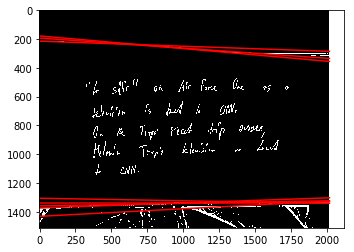

In [497]:
h, theta, d = hough_line(image, )

plt.figure()
plt.imshow(image, cmap='gray')
for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    y0 = (dist - 0 * np.cos(angle)) / np.sin(angle)
    y1 = (dist - image.shape[1] * np.cos(angle)) / np.sin(angle)
    print(y0, y1)
    plt.plot((0, image.shape[1]), (y0, y1), '-r')

In [501]:
from skimage.transform import (hough_line, hough_line_peaks, probabilistic_hough_line)

---- ../../fsdl_data/IMG_20180725_132032.jpg
392
[2240.3582302837194, 2240.3582302837194, 2239.393891212531, 2239.358836810215, 2239.358836810215, 2239.358836810215, 2237.395137207552, 2237.3600514892546, 2237.3600514892546, 2237.3600514892546, 2237.3600514892546, 2236.360659643252, 2236.360659643252, 2236.360659643252, 2236.360659643252, 2235.361268341205, 2235.361268341205, 2221.3349589829986, 2151.3356316483955, 2116.323462989531, 2080.2463796387196, 2070.2524000710637, 2065.313777613465, 2041.753413123142, 2021.7806508125454, 2020.7820268401042, 1967.2104615419266, 1959.1804408986936, 1939.631408283543, 1926.5969998938542, 1873.1281322963466, 1866.5221670261512, 1815.4872624174482, 1796.4609653426928, 1766.0537930652056, 1738.3834444678769, 1723.044979099501, 1586.1730674803428, 1578.9582008400348, 1548.1204733482468, 1541.7175487098796, 1510.0678792690082, 1506.8974749464544, 1500.6082100268545, 1497.9028673448756, 1490.0429524010374, 1471.0166552422172, 1470.541736911945, 1468.54

163
[2303.347346797699, 2303.347346797699, 2303.347346797699, 2303.347346797699, 2290.332071993055, 2272.3520853952186, 2272.334702459125, 2271.3348498184937, 2252.3376745062005, 2217.343004589051, 2210.3266726889037, 2197.328605375172, 2165.3161431994176, 2158.3171685366356, 2124.3222448583456, 2122.322548530265, 2078.311814911324, 2033.3012565775884, 2019.3033452158693, 1903.0, 1779.0, 1694.0277447550852, 1624.258907933092, 1567.2325928208613, 1546.23575175327, 1503.224866744826, 1498.225617188546, 1419.2029453182515, 1415.2208308246456, 1387.0, 1199.1838891512843, 1127.1601483374047, 1116.1617266328387, 1097.164527315753, 1030.3640133467395, 1003.1440574513713, 989.0, 970.1489576348572, 966.598158491935, 966.598158491935, 966.598158491935, 965.3481237356812, 965.2958095837773, 964.5993987143056, 958.5682031029404, 955.1512969158342, 935.2844487106582, 934.5827946201449, 934.5827946201449, 934.5480190980022, 934.1370349151135, 915.5249860052974, 894.1431652705287, 882.1275417988036, 

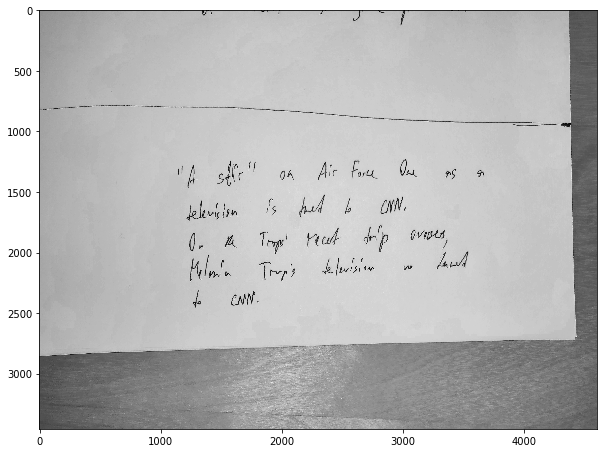

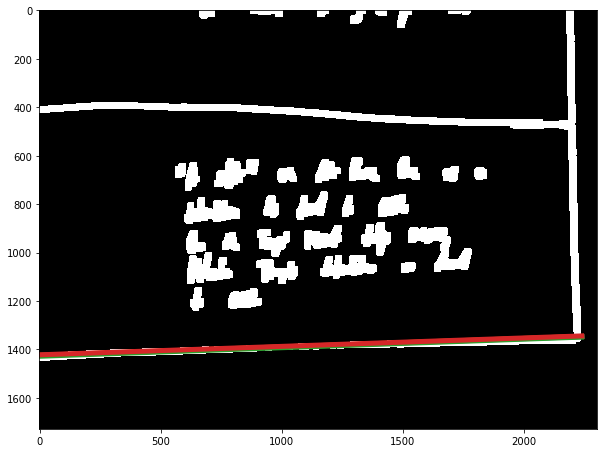

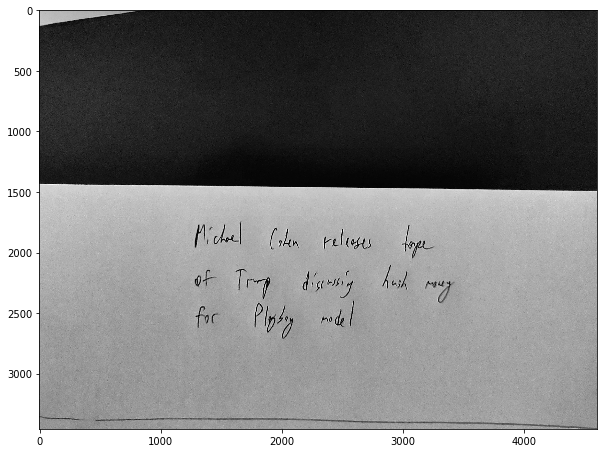

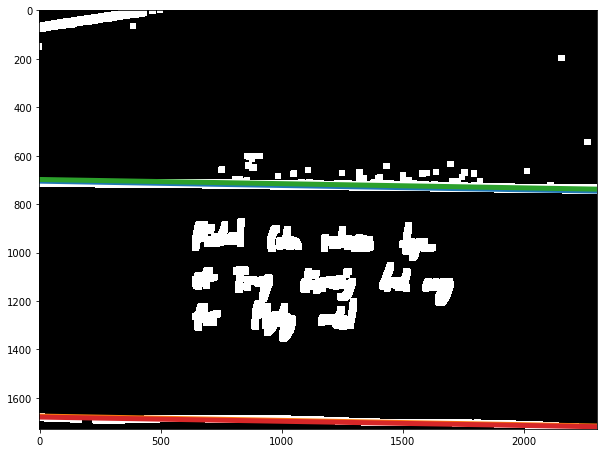

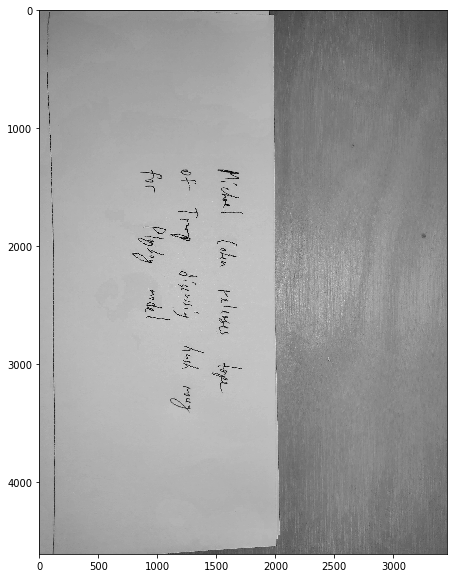

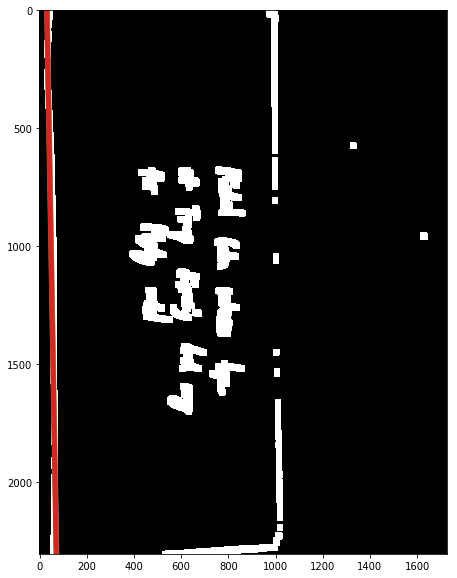

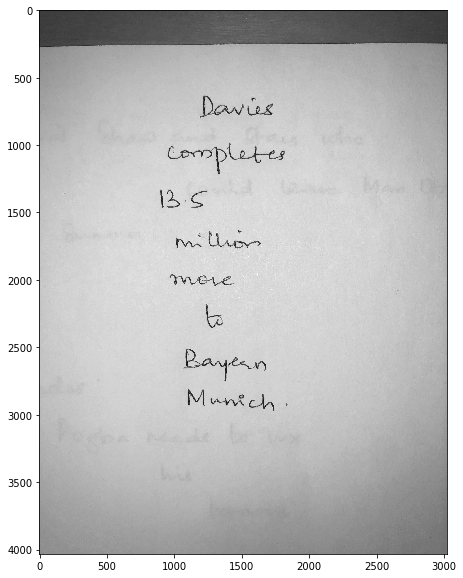

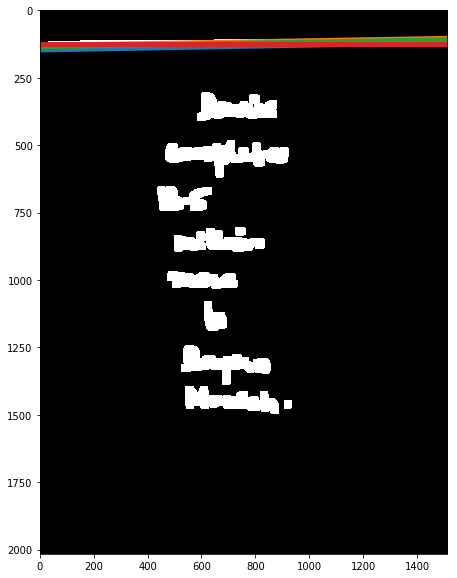

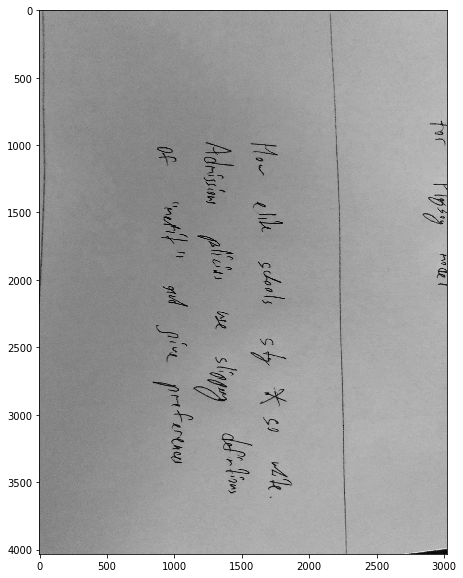

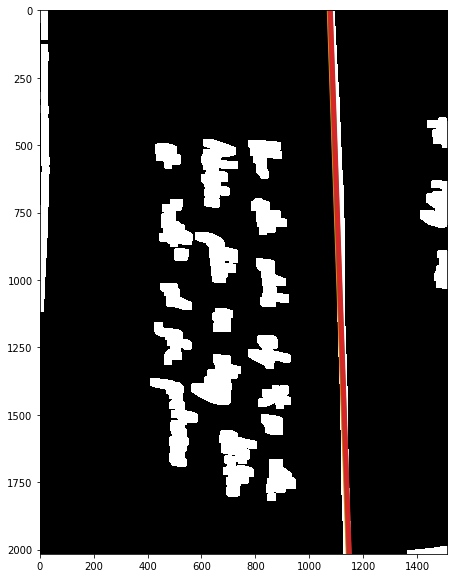

In [531]:
for image_filename in image_filenames[:5]:
    print('----', image_filename)
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')

    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    image = 255 - image
    image = util.resize(image, scale_factor=0.5)
    image = cv2.dilate(image, kernel=np.ones((25, 25), np.uint8))
    image = util.binarize_image(image)

    lines = probabilistic_hough_line(image, threshold=10, line_length=700, line_gap=100)
    print(len(lines))
    lines = sorted(lines, key=lambda x: distance(x[0], x[1]), reverse=True)
    print([distance(p0, p1) for p0, p1 in lines])
    
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    for i, line in enumerate(lines):
        p0, p1 = line
        plt.plot((p0[0], p1[0]), (p0[1], p1[1]), linewidth=5)    
        if i == 3:
            break

In [528]:
import math
def distance(p0, p1):
    return math.hypot(p1[0] - p0[0], p1[1] - p0[1])

s_lines = sorted(lines, key=lambda x: distance(x[0], x[1]), reverse=True)
[distance(p0, p1) for p0, p1 in s_lines]

[595.0840276801251,
 594.084169120841,
 581.0860521471841,
 524.3090691567331,
 520.0778787835529]

IndexError: list index out of range

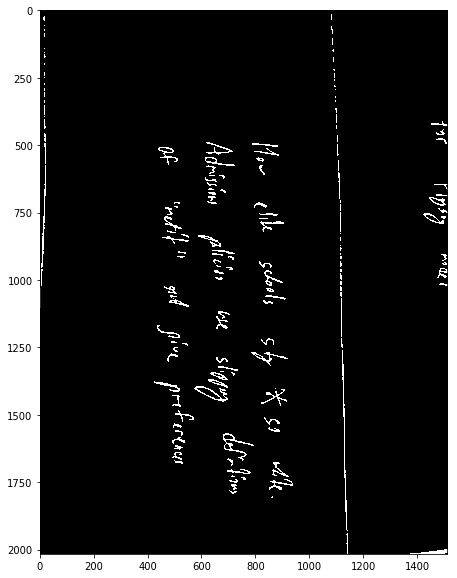

In [520]:
plt.figure(figsize=(10, 10))
plt.imshow(image, cmap='gray')
p0, p1 = lines[5]
plt.plot((p0[0], p1[0]), (p0[1], p1[1]), linewidth=10)

---- ../../fsdl_data/IMG_20180725_132032.jpg
y0, y1 -83116.17196507959 4381.00192950337
x0, x1 2188.638234627591 2234.140412844189
y0, y1 1427.6271142641867 1346.7198099802863
y0, y1 345.41064592480865 507.42504006131855
y0, y1 371.07858106612844 492.5019165725902
y0, y1 388.6273126195642 429.0685012445409
y0, y1 1401.9592757691607 1361.5180871441835
---- ../../fsdl_data/IMG_20180725_132402.jpg
y0, y1 703.730539067859 744.1717276928357
y0, y1 718.6247612432712 718.6247612432711
y0, y1 1672.0477555819848 1712.4889442069614
---- ../../fsdl_data/IMG_20180725_131920.jpg
y0, y1 -5641.821373628066 191267.25900145888
x0, x1 49.51050157290133 69.72953866563522
y0, y1 -1272.8648049509347 64350.015615986274
x0, x1 33.517431250296866 94.18700220576119
y0, y1 9403.035622713647 -187506.04475237828
y0, y1 -113349.32032470917 83559.76005037778
x0, x1 994.710986146471 1014.930023239205
---- ../../fsdl_data/IMG_6723.jpg
y0, y1 124.52470728319076 124.52470728319066
y0, y1 134.54741362377106 108.00788358

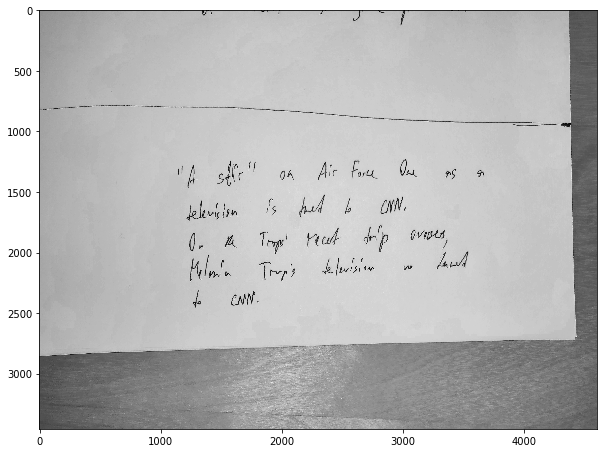

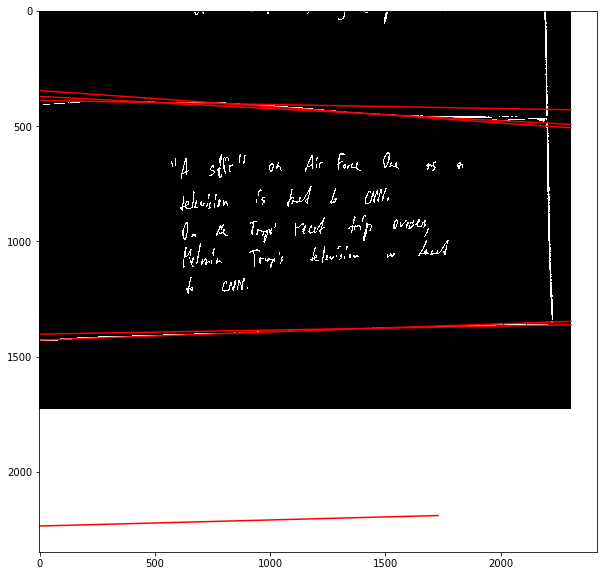

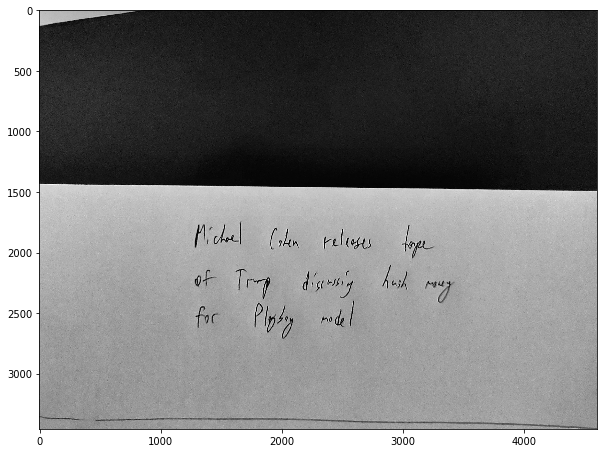

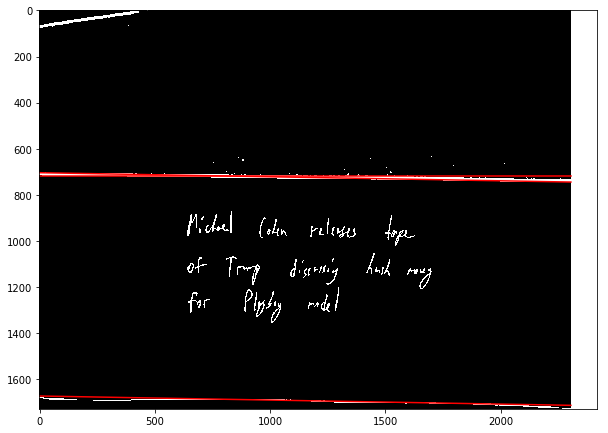

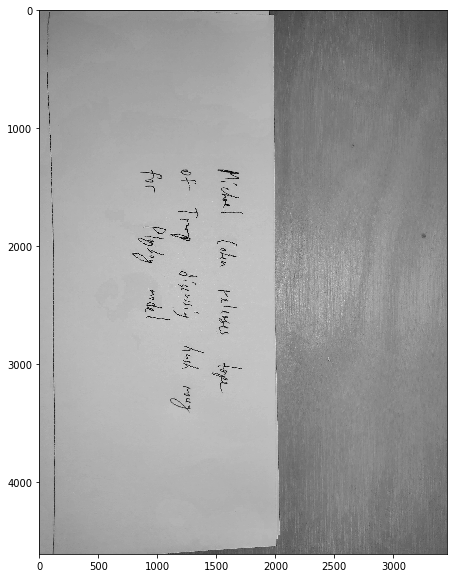

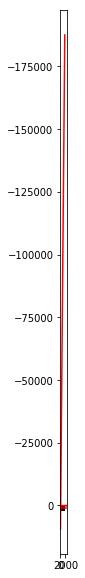

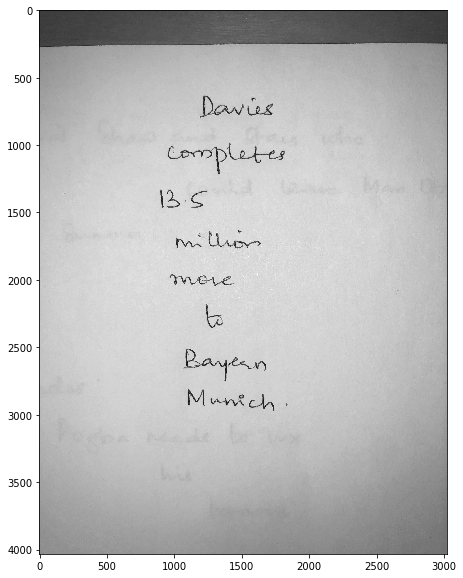

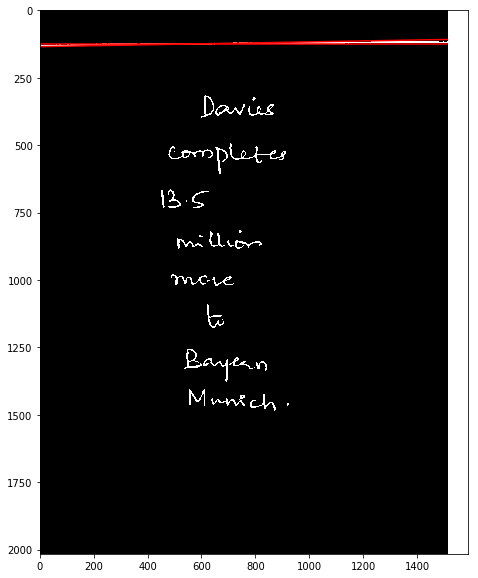

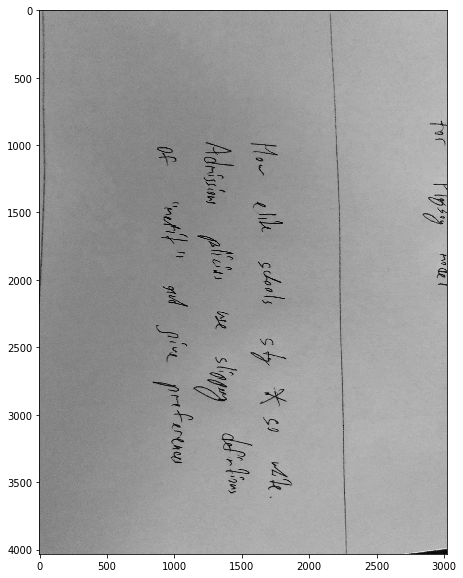

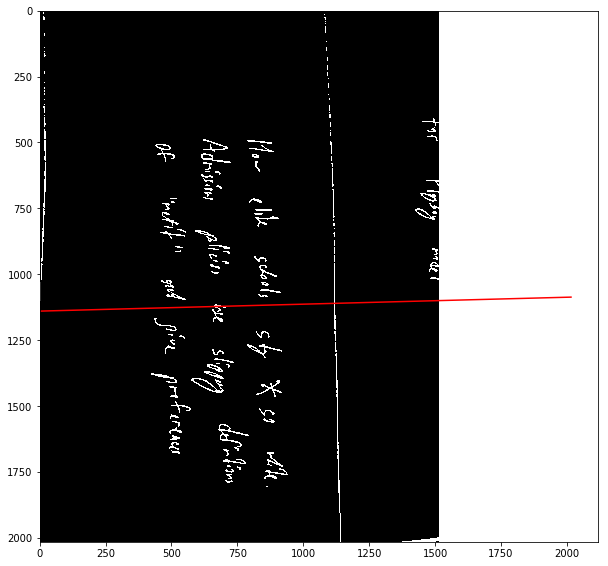

In [500]:
for image_filename in image_filenames[:5]:
    print('----', image_filename)
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')

    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    image = 255 - image
    image = util.resize(image, scale_factor=0.5)
    image = util.binarize_image(image)

    h, theta, d = hough_line(image)

    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
        y0 = (dist - 0 * np.cos(angle)) / np.sin(angle)
        y1 = (dist - image.shape[1] * np.cos(angle)) / np.sin(angle)
        print('y0, y1', y0, y1)
        if y0 >=0 and y1 < image.shape[0]:
            plt.plot((0, image.shape[1]), (y0, y1), '-r')
        else:
            x0 = (dist - 0 * np.sin(angle)) / np.cos(angle)
            x1 = (dist - image.shape[0] * np.sin(angle)) / np.cos(angle)
            print('x0, x1', x0, x1)
            plt.plot((image.shape[0], 0), (x0, x1), '-r')

In [492]:
lines = cv2.HoughLines(image, rho=1, theta=np.pi/180, threshold=200)
lines.shape

(427, 1, 2)

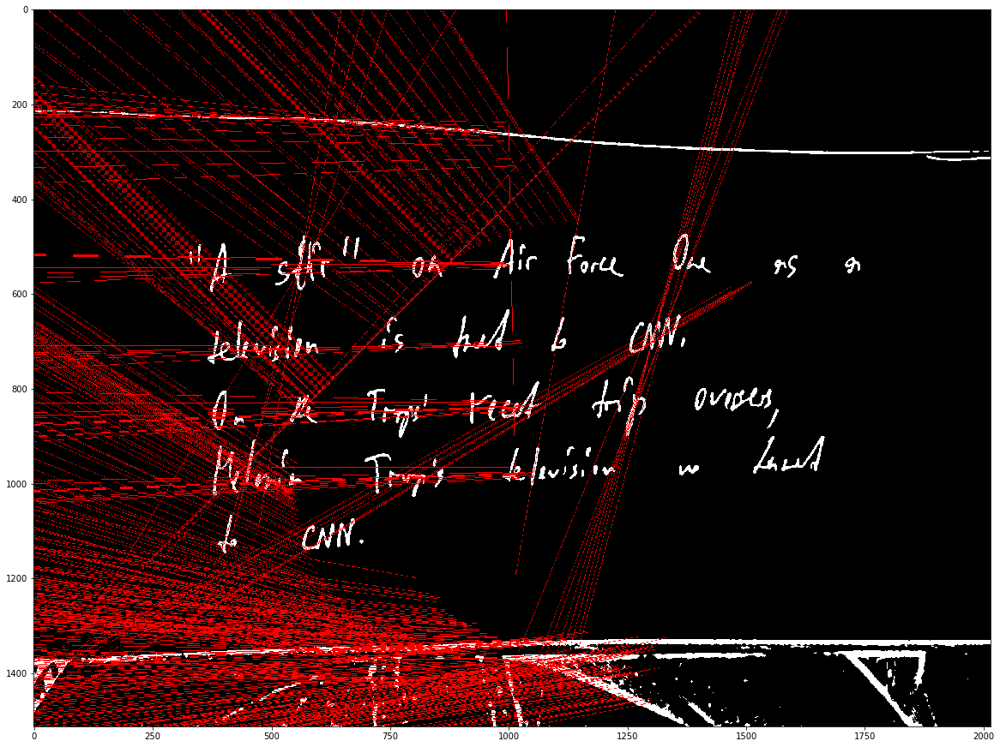

In [493]:
img = np.dstack([image] * 3)
for line in lines:
    rho,theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a*rho
    y0 = b*rho
    x1 = int(x0 + 1000*(-b))
    y1 = int(y0 + 1000*(a))
    x2 = int(x0 - 1000*(-b))
    y2 = int(y0 - 1000*(a))

    cv2.line(img,(x1,y1),(x2,y2),(255,0,0),1)
    
plt.figure(figsize=(20, 20))
plt.imshow(img)    

## Detect `text orientation`

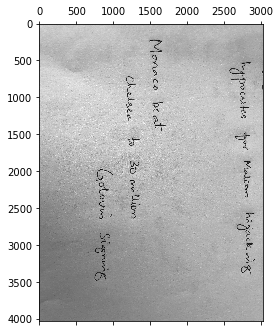

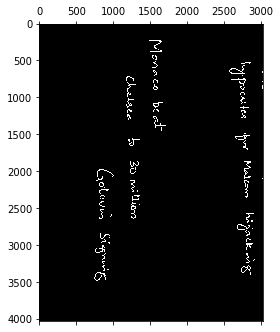

In [532]:
normal_image_filename = f'{data_dir}/IMG_6710.jpg'
rotated_image_filename = f'{data_dir}/IMG_6721.jpg'

image_filename = rotated_image_filename
image = read_grayscale_image(image_filename, use_hsv_step=True)
plt.matshow(image, cmap='gray')

image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
image = 255 - image
plt.matshow(image, cmap='gray')

In [536]:
def get_text_span(image, axis, debug=False):
    img_sum = np.sum(image, axis=axis)
    img_sum = img_sum / img_sum.max()
    
    img_sum = cv2.GaussianBlur(img_sum, (1, 101), 0)
    img_sum = img_sum / img_sum.max()
    
    img_sum[img_sum <= 0.1] = 0
    if debug:
        plt.figure()
        plt.plot(img_sum)
    text_span = len(np.where(img_sum > 0)[0])
    
    labels, num_lines = label(img_sum)
    line_widths = [len(np.where(labels == i+1)[0]) for i in range(num_lines)]
    return text_span, num_lines, line_widths


text_span_w, num_lines_w, line_widths_w = get_text_span(image, axis=0)
text_span_h, num_lines_h, line_widths_h = get_text_span(image, axis=1)

In [237]:
import pandas as pd

all_dicts = []
for image_filename in image_filenames:
    _dict = {}
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    image = 255 - image
    _dict['text_span_w'], _dict['num_lines_w'], _dict['line_widths_w'] = get_text_span(image, axis=0)
    _dict['text_span_h'], _dict['num_lines_h'], _dict['line_widths_h'] = get_text_span(image, axis=1)
    _dict['filename'] = os.path.basename(image_filename)
    all_dicts.append(_dict)

    
df = pd.DataFrame(all_dicts)
df

,filename,line_widths_h,line_widths_w,num_lines_h,num_lines_w,text_span_h,text_span_w
0,IMG_20180725_132032.jpg,"[130, 242, 269, 750, 181, 196]","[584, 291, 353, 634, 389, 48, 125]",6,7,1768,2424
1,IMG_20180725_132402.jpg,"[120, 116, 169, 119, 113, 111]",[4608],6,1,748,4608
2,IMG_20180725_131920.jpg,"[401, 314, 45, 34, 26, 867, 569, 582, 42, 115,...","[117, 238, 264, 242, 107]",15,5,3440,968
3,IMG_6723.jpg,"[87, 135, 127, 130, 105, 86, 105, 125]","[722, 32, 2162]",8,3,900,2916
4,IMG_6737.jpg,"[28, 50, 2841, 64]","[72, 1011, 153, 189]",4,4,2983,1425
5,IMG_6726.jpg,"[81, 62, 127, 23, 70, 34, 24, 42]","[30, 191, 169, 309, 270, 161]",8,6,463,1130
6,IMG_20180725_132359.jpg,"[75, 109, 322, 461, 319, 114]","[1447, 342, 498, 731, 200]",6,5,1400,3218
7,IMG_6740.jpg,"[86, 1121, 650, 583, 224]",[3024],5,1,2664,3024
8,IMG_20180725_132311.jpg,"[199, 168, 107]","[141, 382, 25, 47, 121, 37, 59, 225, 45, 137, ...",3,22,474,2508
9,IMG_6711.jpg,"[219, 194, 185, 186, 199, 99, 394]","[166, 3830]",7,2,1476,3996


In [249]:
images_to_be_rotated = list(range(6716, 6723)) + list(range(6724, 6750)) + ['20180725_131908', '20180725_131920', '20180725_132409', '20180725_132414', '20180725_132419', '20180725_132423', '20180725_132433', '20180725_132438', '20180725_132449', '20180725_132459', '20180725_132504', '20180725_132508']
images_to_be_rotated = [f'IMG_{img}.jpg' for img in images_to_be_rotated]
print('#images which need rotation:', len(images_to_be_rotated))

#images which need rotation: 45


In [250]:
df['to_be_rotated'] = False
df.loc[df.filename.isin(images_to_be_rotated), 'to_be_rotated'] = True

assert df.to_be_rotated.sum() == len(images_to_be_rotated)
df.head()

,filename,line_widths_h,line_widths_w,num_lines_h,num_lines_w,text_span_h,text_span_w,to_be_rotated
0,IMG_20180725_132032.jpg,"[130, 242, 269, 750, 181, 196]","[584, 291, 353, 634, 389, 48, 125]",6,7,1768,2424,False
1,IMG_20180725_132402.jpg,"[120, 116, 169, 119, 113, 111]",[4608],6,1,748,4608,False
2,IMG_20180725_131920.jpg,"[401, 314, 45, 34, 26, 867, 569, 582, 42, 115,...","[117, 238, 264, 242, 107]",15,5,3440,968,True
3,IMG_6723.jpg,"[87, 135, 127, 130, 105, 86, 105, 125]","[722, 32, 2162]",8,3,900,2916,False
4,IMG_6737.jpg,"[28, 50, 2841, 64]","[72, 1011, 153, 189]",4,4,2983,1425,True


In [534]:
# simple check
df['to_be_rotated_pred'] = [row.text_span_w < row.text_span_h for _, row in df.iterrows()]
wrong_pred_df = df[df.to_be_rotated != df.to_be_rotated_pred]
print('#Prediction mistakes:', len(wrong_pred_df))

#Prediction mistakes: 15


In [535]:
wrong_pred_df

,filename,line_widths_h,line_widths_w,num_lines_h,num_lines_w,text_span_h,text_span_w,to_be_rotated,to_be_rotated_pred
5,IMG_6726.jpg,"[81, 62, 127, 23, 70, 34, 24, 42]","[30, 191, 169, 309, 270, 161]",8,6,463,1130,True,False
7,IMG_6740.jpg,"[86, 1121, 650, 583, 224]",[3024],5,1,2664,3024,True,False
14,IMG_6715.jpg,"[206, 252, 190, 180, 127, 196, 276, 195]",[1125],8,1,1622,1125,False,True
15,IMG_6748.jpg,"[85, 24]",[3024],2,1,109,3024,True,False
18,IMG_6732.jpg,"[134, 18, 12, 25, 11, 21, 26, 50]",[3024],8,1,297,3024,True,False
23,IMG_6731.jpg,"[23, 194, 728, 37]","[132, 143, 92, 91, 124, 127, 127, 133, 158]",4,9,982,1127,True,False
35,IMG_6747.jpg,"[93, 16, 30, 19, 18, 41]","[63, 136, 225, 224, 217]",6,5,217,865,True,False
43,IMG_20180725_132259.jpg,"[75, 91, 150]","[129, 14, 42, 23, 34]",3,5,316,242,False,True
45,IMG_20180725_132241.jpg,[3456],"[88, 30]",1,2,3456,118,False,True
49,IMG_6718.jpg,"[159, 18, 30, 11, 25, 411, 55, 35, 37, 17, 40,...","[29, 67, 1125, 319, 20, 48]",16,6,992,1608,True,False


--- IMG_6726.jpg
w: (730, 8, [2, 123, 94, 9, 212, 173, 23, 94])
h: (92, 2, [71, 21])
--- IMG_6740.jpg
w: (1668, 4, [190, 961, 181, 336])
h: (1728, 12, [167, 329, 54, 48, 199, 60, 68, 195, 28, 218, 153, 209])
--- IMG_6715.jpg
w: (1102, 2, [49, 1053])
h: (1282, 8, [186, 164, 174, 157, 114, 122, 192, 173])
--- IMG_6748.jpg
w: (1097, 5, [196, 169, 315, 276, 141])
h: (75, 1, [75])
--- IMG_6732.jpg
w: (325, 1, [325])
h: (121, 1, [121])


/home/saurabh/.local/share/virtualenvs/pandagrader-KaJ4nncx/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


--- IMG_6731.jpg
w: (552, 7, [73, 65, 55, 60, 87, 68, 144])
h: (812, 2, [174, 638])
--- IMG_6747.jpg
w: (604, 4, [69, 171, 165, 199])
h: (81, 1, [81])
--- IMG_20180725_132259.jpg
w: (109, 1, [109])
h: (159, 2, [27, 132])
--- IMG_20180725_132241.jpg
w: (77, 1, [77])
h: (1407, 12, [46, 196, 16, 271, 317, 161, 181, 26, 80, 40, 14, 59])
--- IMG_6718.jpg
w: (909, 7, [139, 17, 151, 311, 198, 54, 39])
h: (193, 3, [133, 43, 17])
--- IMG_6743.jpg
w: (887, 4, [220, 191, 167, 309])
h: (76, 1, [76])
--- IMG_20180725_132216.jpg
w: (238, 2, [95, 143])
h: (613, 4, [185, 166, 171, 91])
--- IMG_20180725_132419.jpg
w: (460, 2, [317, 143])
h: (164, 2, [32, 132])
--- IMG_6745.jpg
w: (1093, 9, [136, 153, 101, 91, 123, 136, 135, 148, 70])
h: (957, 2, [85, 872])
--- IMG_20180725_132248.jpg
w: (82, 1, [82])
h: (1179, 9, [47, 104, 272, 323, 147, 163, 35, 40, 48])


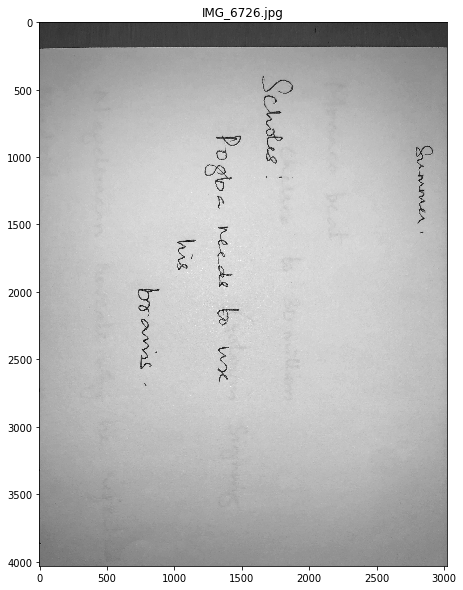

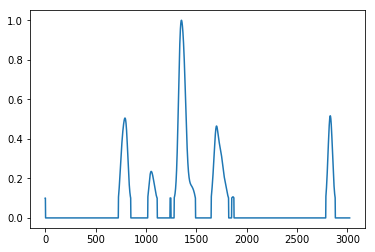

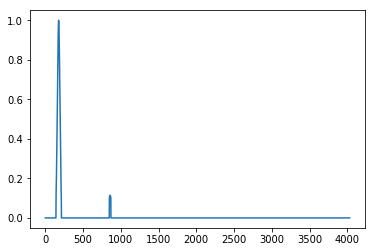

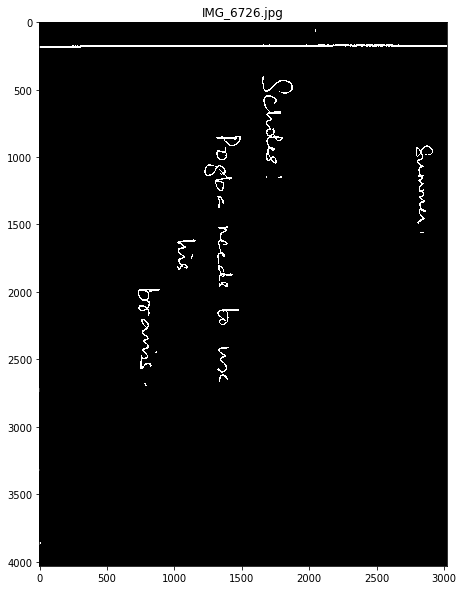

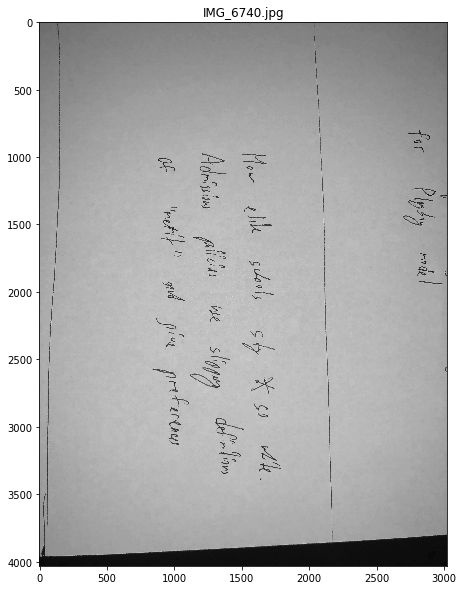

...

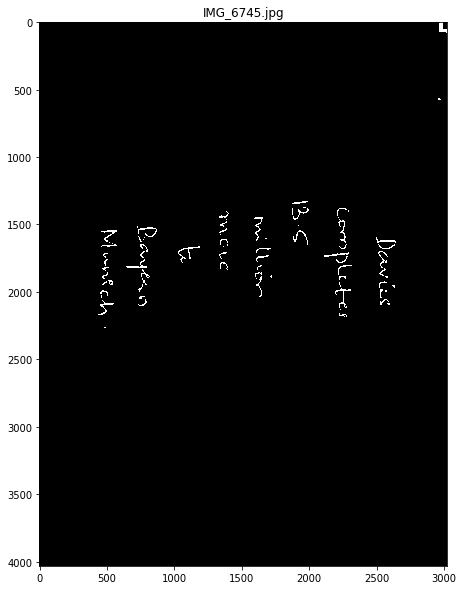

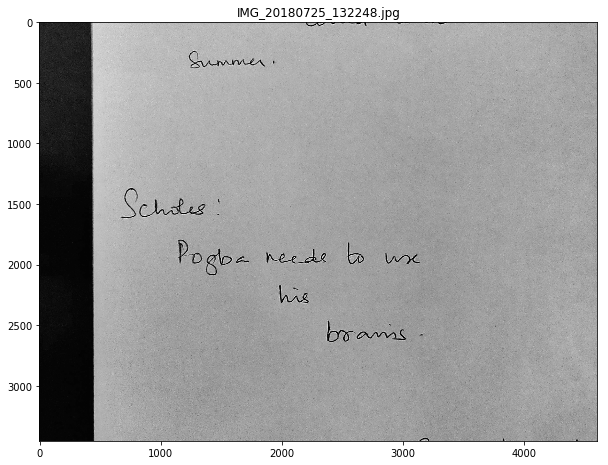

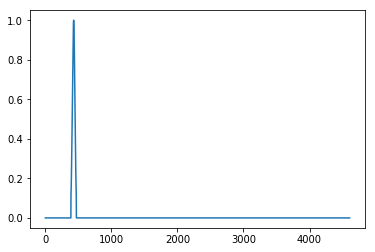

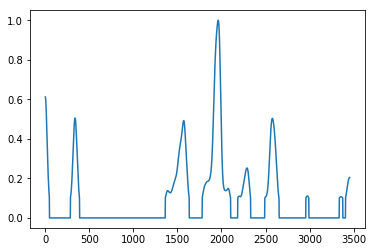

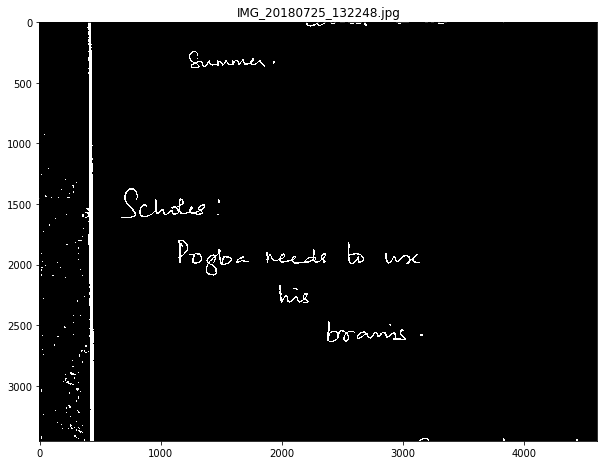

In [537]:
for _, row in wrong_pred_df.iterrows():
    image = read_grayscale_image(f'{data_dir}/{row.filename}', use_hsv_step=True)
    plt.figure(figsize=(10, 10))
    plt.title(row.filename)
    plt.imshow(image, cmap='gray')

    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    image = 255 - image

    print('---', row.filename)
    print('w:', get_text_span(image, axis=0, debug=True))
    print('h:', get_text_span(image, axis=1, debug=True))

    plt.figure(figsize=(10, 10))
    plt.title(row.filename)
    plt.imshow(image, cmap='gray')

TypeError: an integer is required (got type tuple)

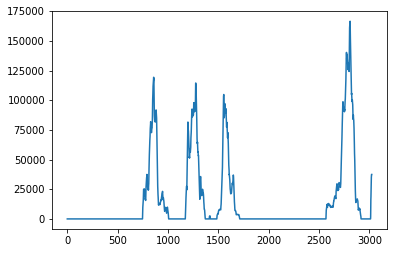

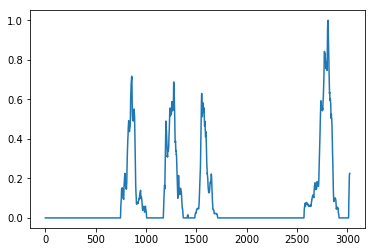

In [189]:
vert_sum = np.sum(image, axis=0)
plt.figure()
plt.plot(vert_sum)

vert_sum = vert_sum / vert_sum.max()
plt.figure()
plt.plot(vert_sum)

vert_sum_smooth = cv2.GaussianBlur(vert_sum, (1, 201), 0)
vert_sum_smooth = vert_sum_smooth / vert_sum_smooth.max()
plt.figure()
plt.plot(vert_sum_smooth)

vert_sum_smooth[vert_sum_smooth <= 0.1] = 0
vert_sum_smooth_lbl, vert_sum_smooth_nf = label(vert_sum_smooth)
vert_sum_smooth_nf
plt.figure()
plt.plot(vert_sum_smooth_lbl)

find_objects(vert_sum_smooth_lbl)

3168
3


[(slice(201, 1458, None), slice(0, 1, None)),
 (slice(1467, 1721, None), slice(0, 1, None)),
 (slice(1845, 3502, None), slice(0, 1, None))]

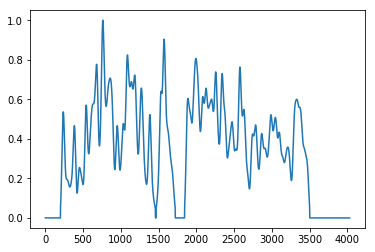

In [196]:
horz_sum = np.sum(image, axis=1)
horz_sum = horz_sum / horz_sum.max()
horz_sum = cv2.GaussianBlur(horz_sum, (1, 101), 0)
horz_sum = horz_sum / horz_sum.max()
horz_sum[horz_sum <= 0.05] = 0
horz_text_extent = len(np.where(horz_sum > 0)[0])
print(horz_text_extent)
plt.figure()
plt.plot(horz_sum)
lbl, nf = label(horz_sum)
print(nf)
find_objects(lbl)

[(slice(187, 1723, None), slice(0, 1, None)),
 (slice(1829, 3509, None), slice(0, 1, None))]

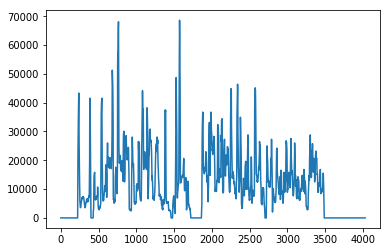

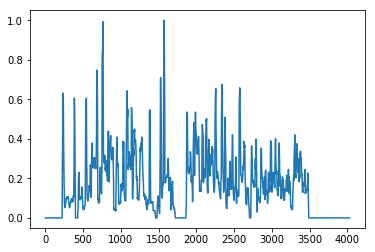

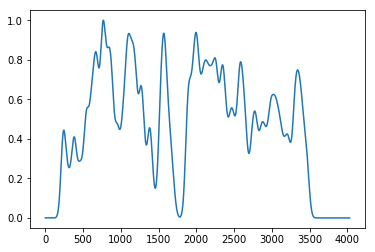

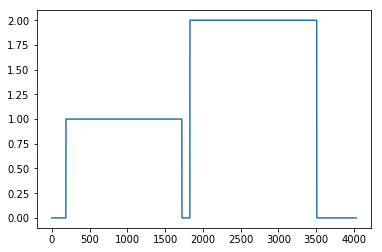

In [182]:
horz_sum = np.sum(image, axis=1)
plt.figure()
plt.plot(horz_sum)
horz_sum = horz_sum / horz_sum.max()
plt.figure()
plt.plot(horz_sum)

horz_sum_smooth = cv2.GaussianBlur(horz_sum, (1, 201), 0)
horz_sum_smooth = horz_sum_smooth / horz_sum_smooth.max()
plt.figure()
plt.plot(horz_sum_smooth)

horz_sum_smooth[horz_sum_smooth <= 0.1] = 0
horz_sum_smooth_lbl, horz_sum_smooth_nf = label(horz_sum_smooth)
horz_sum_smooth_nf
plt.figure()
plt.plot(horz_sum_smooth_lbl)

find_objects(horz_sum_smooth_lbl)

In [94]:
from skimage.transform import (hough_line, hough_line_peaks, probabilistic_hough_line)

In [136]:
from scipy.ndimage import center_of_mass, label, find_objects

In [109]:
hspace, theta, distances = hough_line(image)

479 0.043876992368572454 1144.613552931838
26095.245825784517 -42780.467749074254
476 0.11408018015828847 1376.636571088401
12093.486351628804 -14299.092956318738
471 -0.09652938321085958 682.5677150510965
-7082.080756651343 24147.805882987333
450 -0.07897858626343068 731.5725766445084
-9272.559943850825 28936.656105506976
446 -0.008775398473714668 1100.6091874193871
-125421.4628230376 219169.42783336455
446 -0.11408018015828869 1082.6074015279291
-9510.49689476074 16882.082413186752
445 0.02632619542114334 1221.6211925786283
46408.61680363011 -68431.42393301097
443 -0.043876992368572676 1180.6171247147531
-26916.066140094776 41959.64743476363
438 0.06142778931600135 1157.614842742335
18856.98956587527 -30309.609398248285
435 1.5707963267948966 1168.6159341204484
1168.6159341204484 1168.6159341204482
434 0.02632619542114334 1129.6120646889567
42913.24820278363 -71926.79253385744
431 0.043876992368572454 1275.6265502530014
29082.1197473029 -39793.59382755587
428 -0.06142778931600157 789

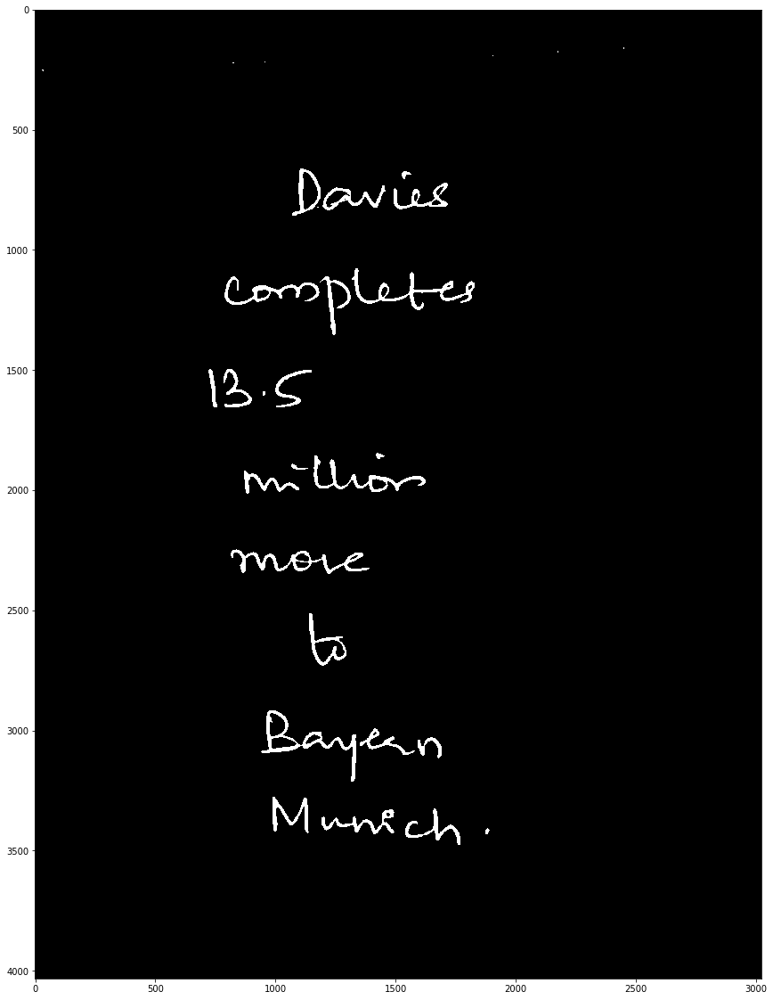

In [110]:
plt.figure(figsize=(20, 20))
plt.imshow(image, cmap='gray')
for accum, angle, dist in zip(*hough_line_peaks(hspace, theta, distances)):
    print(accum, angle, dist)
    y0 = (dist - 0 * np.cos(angle)) / np.sin(angle)
    y1 = (dist - image.shape[1] * np.cos(angle)) / np.sin(angle)
    print(y0, y1)
#     plt.plot((0, image.shape[1]), (y0, y1), '-r')
    
# plt.set_xlim((0, image.shape[1]))
# plt.set_ylim((image.shape[0], 0))
# plt.set_axis_off()
# plt.set_title('Detected lines')

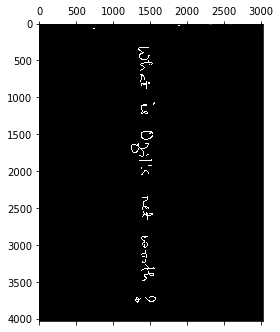

In [152]:
plt.matshow(image, cmap='gray')

27

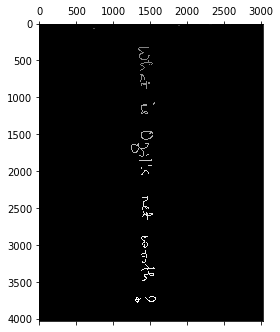

In [153]:
## text has to be white in black background for this to work
lbl, num_features = label(image)
plt.matshow(lbl, cmap='gray')
num_features

In [154]:
objs = find_objects(lbl)
len(objs), objs

(27,
 [(slice(0, 4, None), slice(2097, 2104, None)),
  (slice(8, 22, None), slice(2549, 2626, None)),
  (slice(8, 16, None), slice(2656, 2698, None)),
  (slice(10, 18, None), slice(2480, 2505, None)),
  (slice(15, 29, None), slice(2295, 2345, None)),
  (slice(32, 40, None), slice(1883, 1903, None)),
  (slice(54, 57, None), slice(1248, 1257, None)),
  (slice(71, 78, None), slice(732, 758, None)),
  (slice(161, 163, None), slice(2517, 2527, None)),
  (slice(162, 165, None), slice(3021, 3024, None)),
  (slice(163, 165, None), slice(2953, 2960, None)),
  (slice(165, 166, None), slice(3014, 3019, None)),
  (slice(166, 167, None), slice(3020, 3024, None)),
  (slice(321, 683, None), slice(1337, 1534, None)),
  (slice(683, 895, None), slice(1367, 1506, None)),
  (slice(1073, 1124, None), slice(1533, 1565, None)),
  (slice(1100, 1232, None), slice(1371, 1474, None)),
  (slice(1459, 1581, None), slice(1371, 1545, None)),
  (slice(1619, 1809, None), slice(1240, 1481, None)),
  (slice(1770, 1797, 

In [156]:
centroids = center_of_mass(image, lbl, range(1, num_features+1))
centroids = [[j, i] for i, j in centroids]
len(centroids)

27

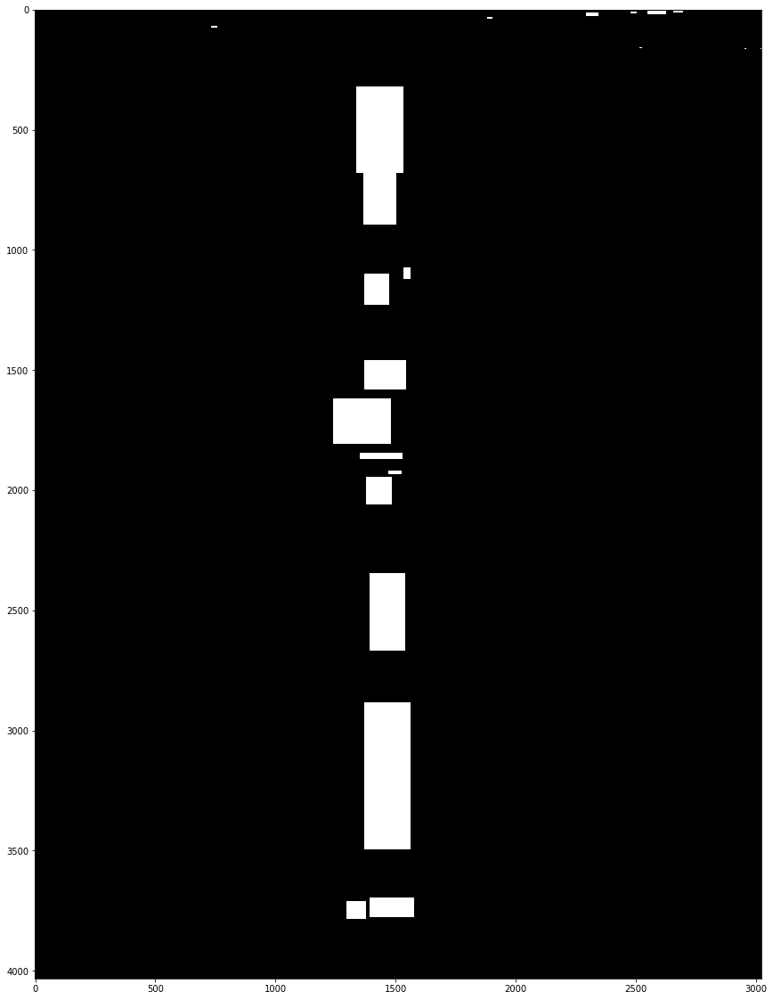

In [159]:
temp = np.zeros_like(image)
for obj in objs:
    temp[obj] = 255

plt.figure(figsize=(20, 20))
plt.imshow(temp, cmap='gray')

## Current solution so far

In [543]:
def extract_text_regions(img: np.ndarray,
                         merge_fully_overlapping_regions: bool = True,
                         suppress_show: bool = True,
                         params = None,
                         merge_bboxes_in_line = True,
                         scan_order: bool = True):
    """
    Takes in an image with **black** text on a **white** background, and returns the list of region images
    and their corresponding bounding boxes. If suppress_show is true, it shows the image after each
    step of processing. The params variable is a
    """
    if not params:
        params = _DEFAULT_PARAMS

    preprocessed_image = horizontally_dilate_image(image, dilation_kernel_length=int(params['dilation_kernel_length']))

    # Find contours and initial bboxes
    bboxes, contours = tre.find_bboxes(preprocessed_image)
    if not suppress_show:
        print('Initial contours and bboxes:')
        plotting_util.show_contours(contours, preprocessed_image)
        plotting_util.show_bboxes(bboxes, img)

    # Shrinks the width of the bboxes by 48px
    if params['perform_trimming']:
        bboxes = tre.trim_bboxes(bboxes, img.shape[1])
    if not suppress_show:
        print('After trimming bboxes')
        plotting_util.show_bboxes(bboxes, img)

    # Merges nearby bboxes
    bboxes = tre.merge_close_bboxes(bboxes,
                                merge_area_percentage_cutoff=params['merge_area_percentage_cutoff'],
                                merge_area_absolute_cutoff=params['merge_area_absolute_cutoff'],
                                merge_distance_cutoff=params['merge_distance_cutoff'],
                                merge_fully_overlapping_regions=merge_fully_overlapping_regions)
    if not suppress_show:
        print('After merging regions')
        plotting_util.show_bboxes(bboxes, img)

    # Discards regions with little text (small percentage of white pixels)
    regions = tre.bboxes_to_regions(bboxes, img)
    region_bbox_pairs = tre.discard_regions_with_little_text(
        list(zip(regions, bboxes)),
        discard_text_percentage_cutoff=params['discard_text_percentage_cutoff'],
        discard_area_percentage_cutoff=params['discard_area_percentage_cutoff'],
        discard_area_absolute_cutoff=params['discard_area_absolute_cutoff']
    )
    if region_bbox_pairs:
        regions, bboxes = zip(*region_bbox_pairs)
    else:
        regions, bboxes = [], []
    if not suppress_show:
        print('After discarding regions')
        plotting_util.show_bboxes(bboxes, img)

    # Discards regions with aspect ratio that does not resemble a horizontal line
    bboxes = tre.discard_bboxes_with_bad_aspect_ratio(
        bboxes,
        aspect_ratio_percentage_cutoff=params['aspect_ratio_percentage_cutoff'],
        min_height_cutoff=params['min_height_cutoff']
    )
    if not suppress_show:
        print('After removing non-line regions')
        plotting_util.show_bboxes(bboxes, img)

    if merge_bboxes_in_line:
        bboxes_per_line = tre.decompose_into_lines(bboxes)
        bboxes = [get_overlapping_bbox(bboxes) for bboxes in bboxes_per_line]
        bboxes.sort(key=lambda line_bbox: line_bbox['y1'])

    # Recalculates regions based on bboxes
    regions = tre.bboxes_to_regions(bboxes, img)
    if not suppress_show:
        plotting_util.show_regions(regions)

    return list(regions), list(bboxes)

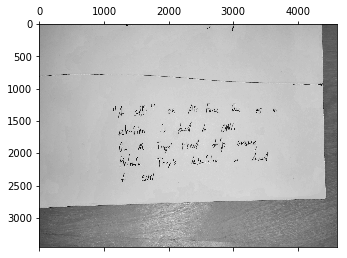

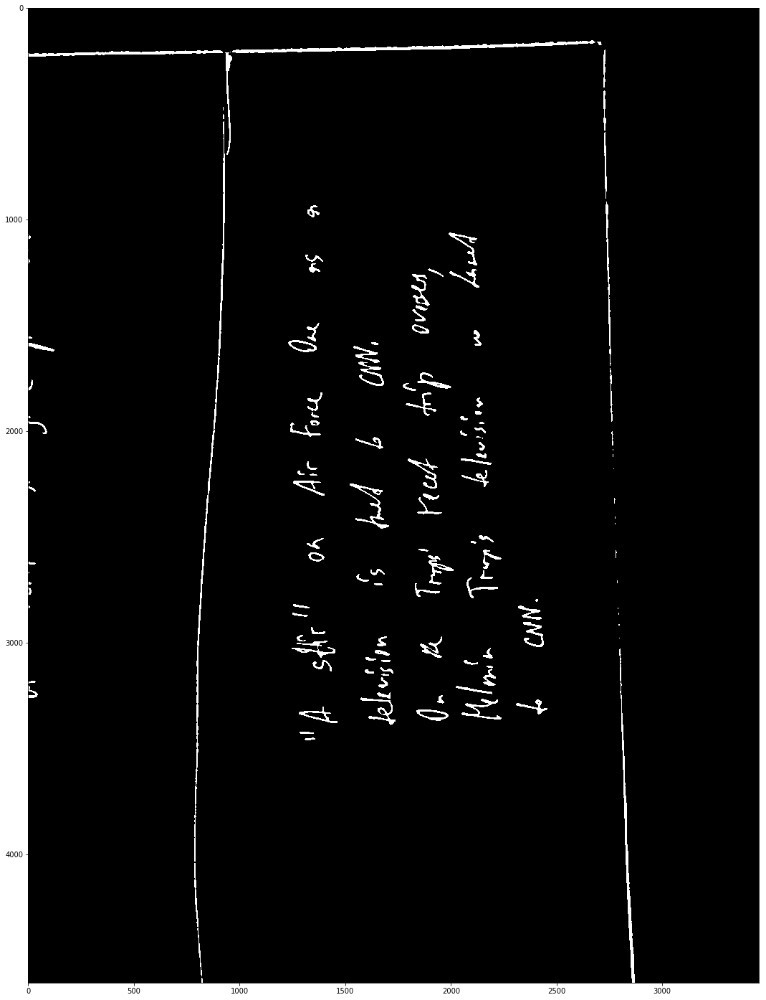

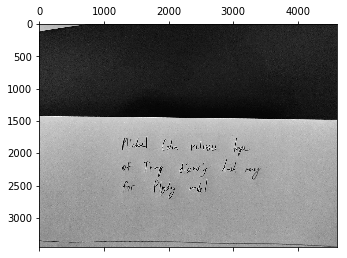

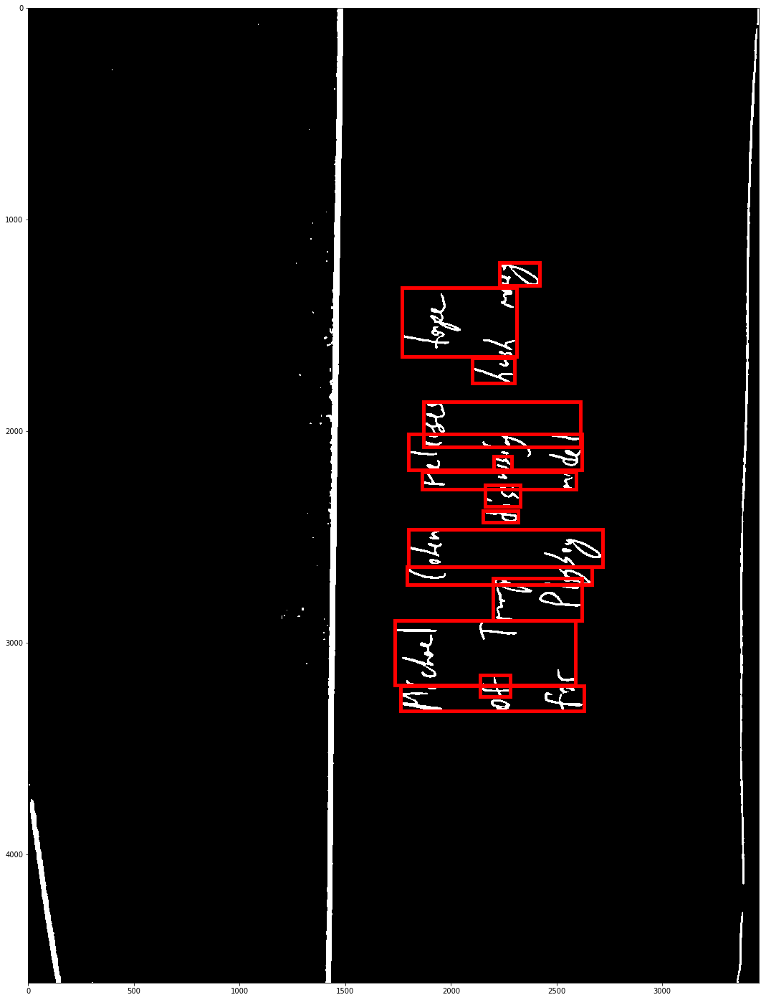

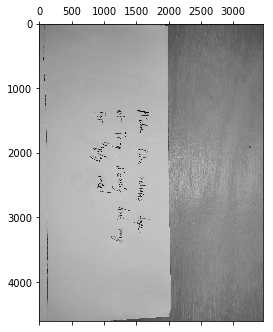

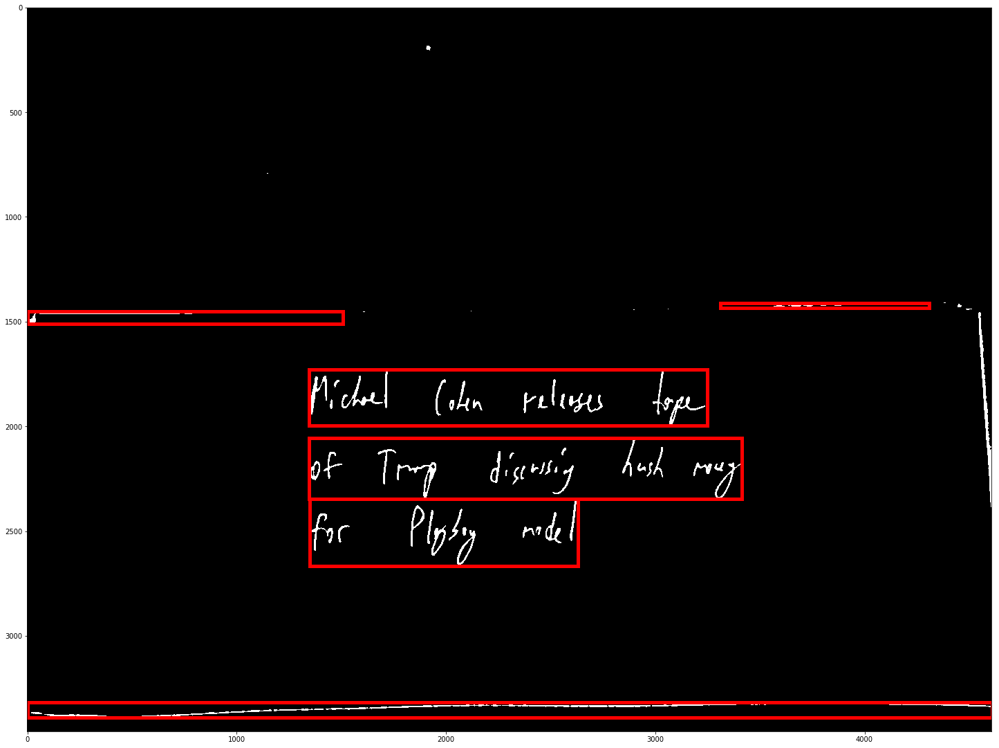

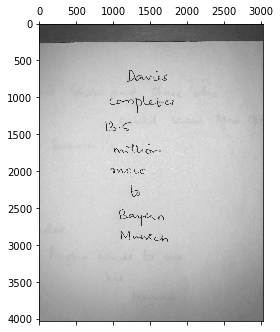

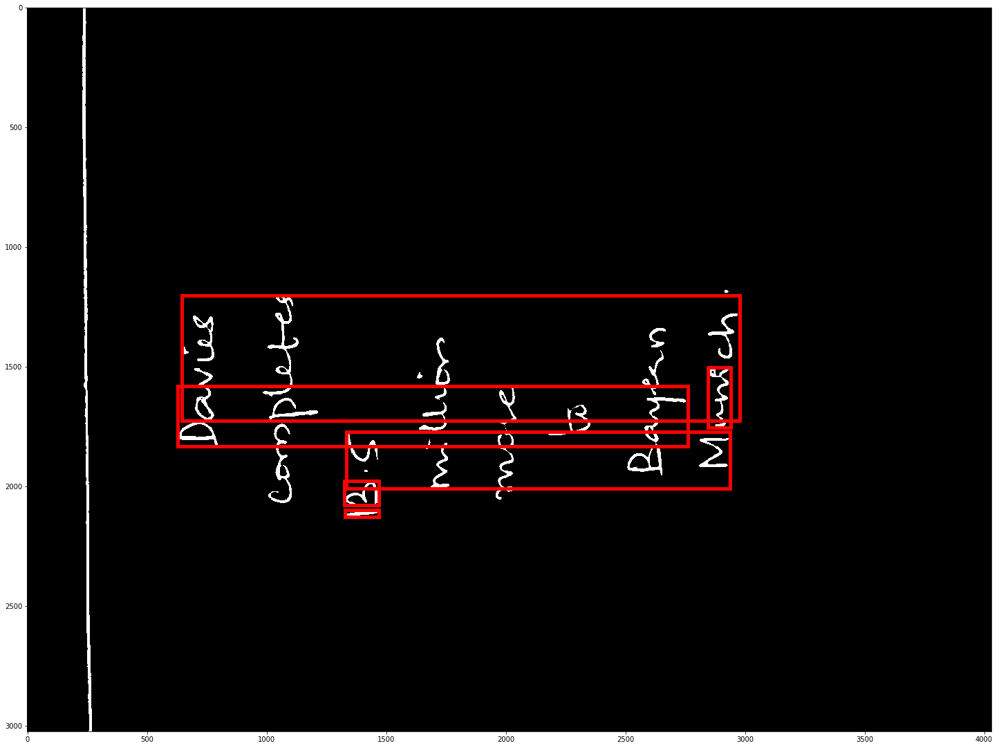

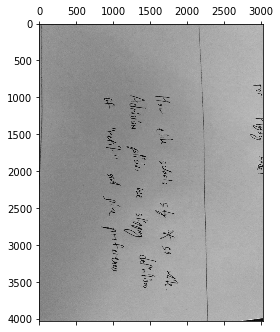

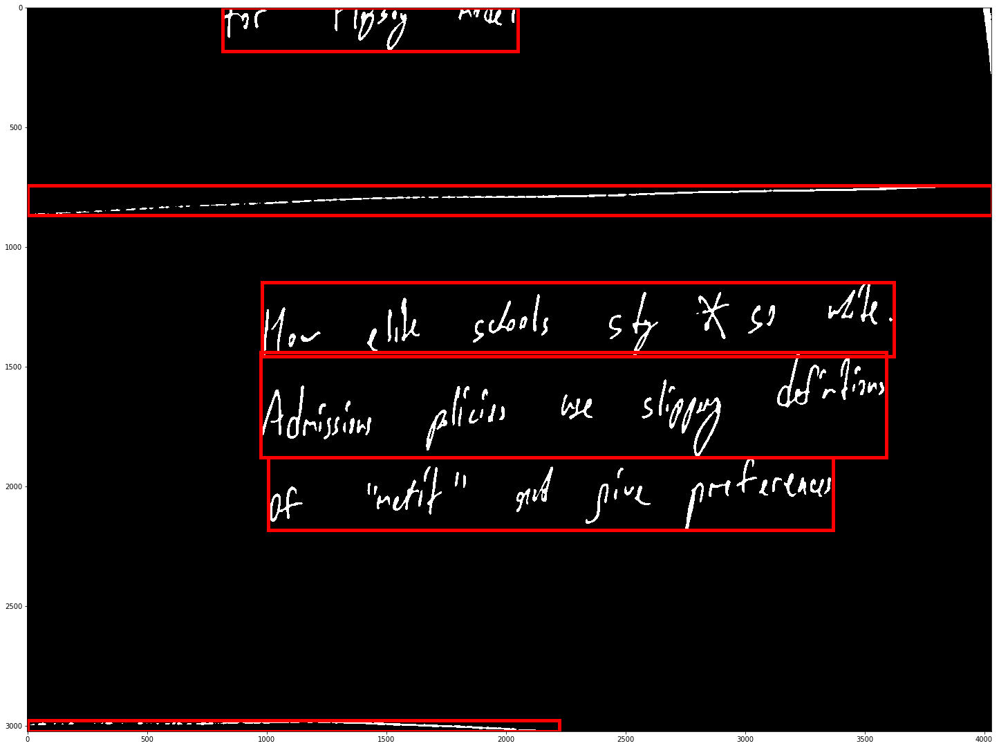

In [547]:
for image_filename in image_filenames[:5]:
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    plt.matshow(image, cmap='gray')
    image = read_grayscale_image(image_filename, use_hsv_step=True)
    image = cleanup_image(image, blur_kernel_size=int(tre_params['gaussian_blur_size']))
    
    white_text_image = (255 - image).astype('uint8')
    
    text_span_w, _, _ = get_text_span(white_text_image, axis=0)
    text_span_h, _, _ = get_text_span(white_text_image, axis=1)
    to_be_rotated = text_span_w < text_span_h
    
    image = np.rot90(white_text_image)
    
    regions, bboxes = extract_text_regions(
        image,
        merge_fully_overlapping_regions=True,  # False
        suppress_show=True,
        params=tre_params,
        scan_order=True
    )
    plotting_util.show_bboxes(bboxes, image)

#     for i, region in enumerate(regions):
#         region_filename = os.path.splitext(image_filename)[0] + f'_lineRegion-{i}.jpg'
#         util.write_image(region_filename, region)